In [2]:
import numpy as np
import os
import librosa
import matplotlib.pyplot as plt
import scipy
from pathlib import Path

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [12]:


# Définir les chemins
base_path = Path("/content/drive/MyDrive/Signal_MVA/data/")
base_path="data"
dir_packet_loss = os.path.join(base_path, "packet_loss", "train_small")
dir_voice_origin = os.path.join(base_path, "voice_origin", "train_small")

# Fonction pour récupérer le premier fichier wav d'un dossier
def get_first_wav(directory):
    files = os.listdir(directory)
    for file in files:
        if file.endswith(".wav"):
            return os.path.join(directory, file)
    return None

# Récupérer les chemins des fichiers
file_pl = get_first_wav(dir_packet_loss)
file_vo = get_first_wav(dir_voice_origin)

# Charger les fichiers audio
if file_pl:
    y_pl, sr_pl = librosa.load(file_pl, sr=None)
    print(f"Fichier Packet Loss chargé : {file_pl}")
    print(f"Dimensions : {y_pl.shape}, Fréquence : {sr_pl} Hz")

if file_vo:
    y_vo, sr_vo = librosa.load(file_vo, sr=None)
    print(f"Fichier Voice Origin chargé : {file_vo}")
    print(f"Dimensions : {y_vo.shape}, Fréquence : {sr_vo} Hz")

Fichier Packet Loss chargé : data\packet_loss\train_small\Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav
Dimensions : (80000,), Fréquence : 8000 Hz
Fichier Voice Origin chargé : data\voice_origin\train_small\Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav
Dimensions : (40000,), Fréquence : 4000 Hz


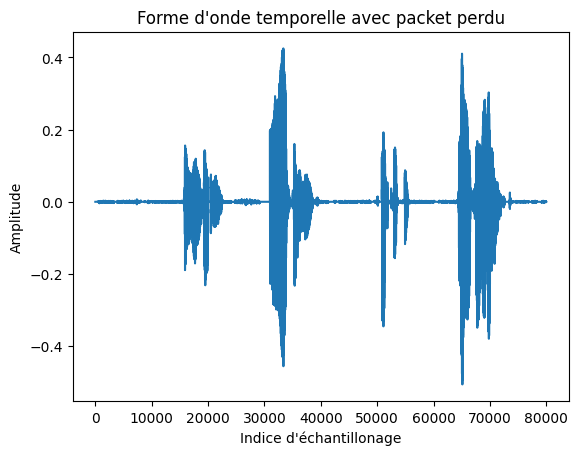

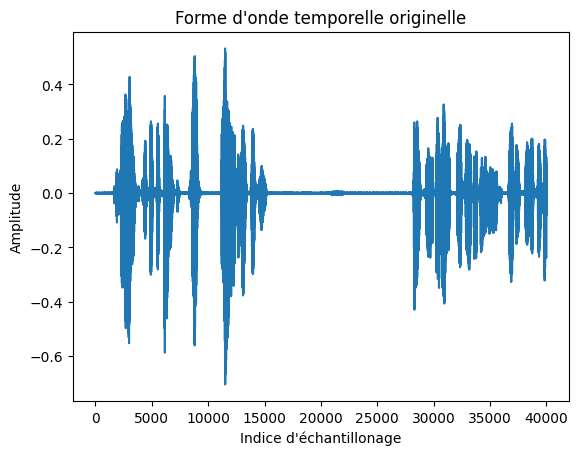

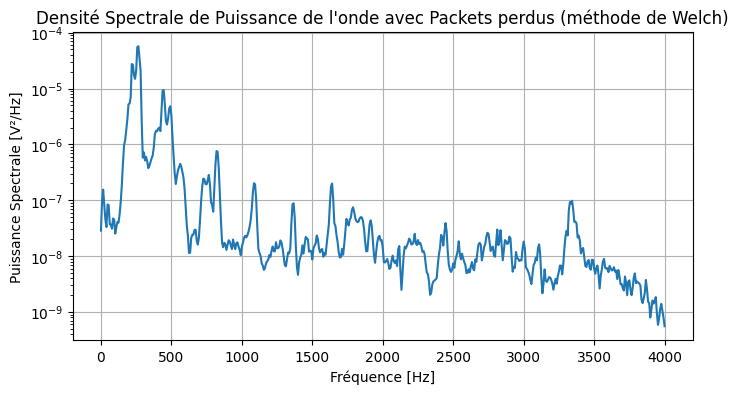

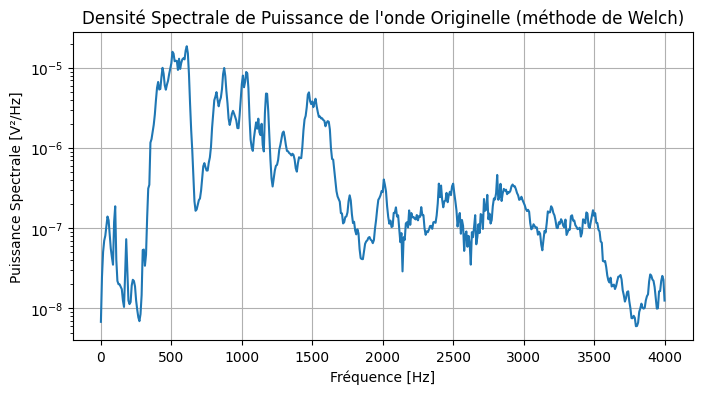

In [4]:
### FORME d'onde TEMPORELLE ###
T=[i for i in range(len(y_pl))]
plt.plot(T, y_pl)
plt.title("Forme d'onde temporelle avec packet perdu")
plt.xlabel("Indice d'échantillonage")
plt.ylabel("Amplitude")
plt.show()

plt.plot(T[0:len(y_vo)],y_vo)
plt.title("Forme d'onde temporelle originelle")
plt.xlabel("Indice d'échantillonage")
plt.ylabel("Amplitude")
plt.show()

### DENSITE SPECTRALE ###


# --- Calcul de la Densité Spectrale de Puissance (DSP) ---
frequencies, psd = scipy.signal.welch(y_pl, fs=8000, nperseg=1024)

# --- Affichage ---
plt.figure(figsize=(8, 4))
plt.semilogy(frequencies, psd)
plt.title("Densité Spectrale de Puissance de l'onde avec Packets perdus (méthode de Welch)")
plt.xlabel("Fréquence [Hz]")
plt.ylabel("Puissance Spectrale [V²/Hz]")
plt.grid(True)
plt.show()

# --- Calcul de la Densité Spectrale de Puissance (DSP) ---
frequencies, psd = scipy.signal.welch(y_vo, fs=8000, nperseg=1024)

# --- Affichage ---
plt.figure(figsize=(8, 4))
plt.semilogy(frequencies, psd)
plt.title("Densité Spectrale de Puissance de l'onde Originelle (méthode de Welch)")
plt.xlabel("Fréquence [Hz]")
plt.ylabel("Puissance Spectrale [V²/Hz]")
plt.grid(True)
plt.show()

/tmp/ipython-input-3670535170.py:7: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t, f, 10 * np.log10(Sxx_empty), shading='gouraud')


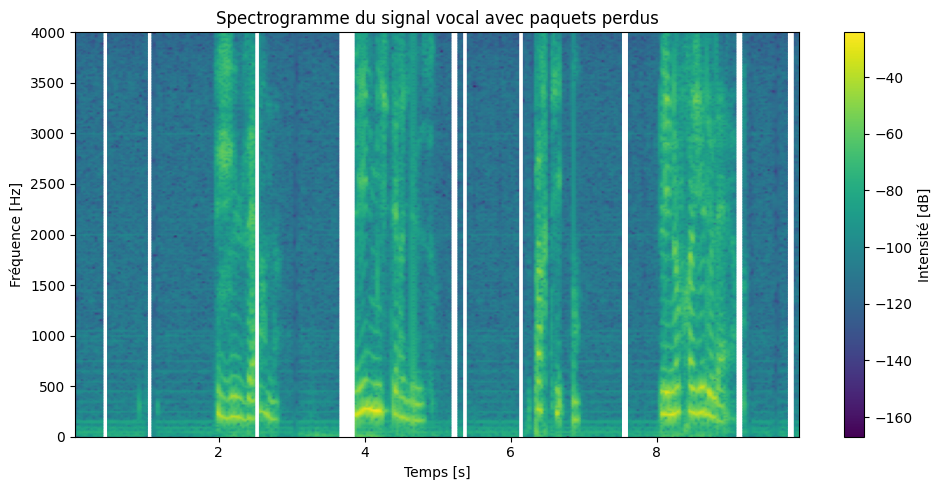

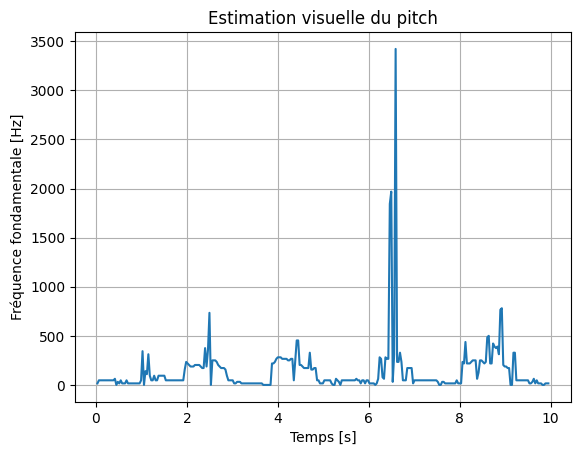

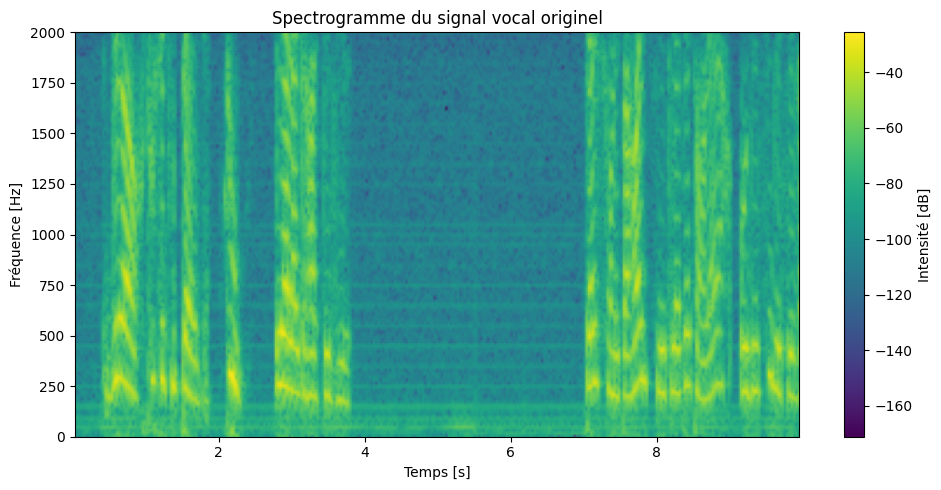

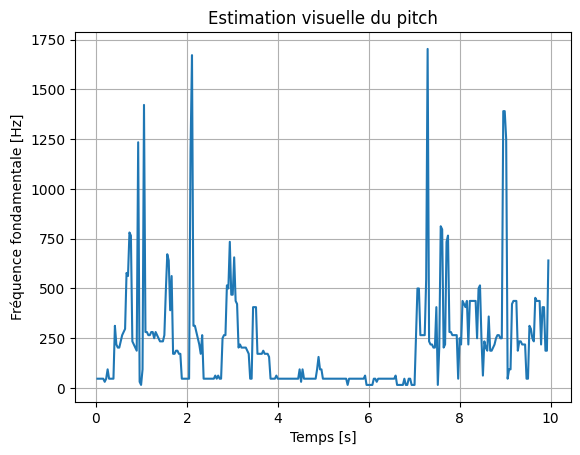

In [5]:
# --- Calcul du spectrogramme ---
f, t, Sxx_empty = scipy.signal.spectrogram(y_pl, fs=8000, nperseg=512, noverlap=256)


# --- Affichage ---
plt.figure(figsize=(10, 5))
plt.pcolormesh(t, f, 10 * np.log10(Sxx_empty), shading='gouraud')
plt.title("Spectrogramme du signal vocal avec paquets perdus")
plt.xlabel("Temps [s]")
plt.ylabel("Fréquence [Hz]")
plt.colorbar(label="Intensité [dB]")
plt.tight_layout()
plt.show()

pitch_estim = f[np.argmax(Sxx_empty, axis=0)]

plt.plot(t, pitch_estim)
plt.title("Estimation visuelle du pitch")
plt.xlabel("Temps [s]")
plt.ylabel("Fréquence fondamentale [Hz]")
plt.grid(True)
plt.show()


# --- Calcul du spectrogramme ---
f, t, Sxx = scipy.signal.spectrogram(y_vo, fs=4000, nperseg=256, noverlap=128)


# --- Affichage ---
plt.figure(figsize=(10, 5))
plt.pcolormesh(t, f, 10 * np.log10(Sxx), shading='gouraud')
plt.title("Spectrogramme du signal vocal originel")
plt.xlabel("Temps [s]")
plt.ylabel("Fréquence [Hz]")
plt.colorbar(label="Intensité [dB]")
plt.tight_layout()
plt.show()
pitch_estim = f[np.argmax(Sxx, axis=0)]

plt.plot(t, pitch_estim)
plt.title("Estimation visuelle du pitch")
plt.xlabel("Temps [s]")
plt.ylabel("Fréquence fondamentale [Hz]")
plt.grid(True)
plt.show()

Chirurgie audio : Remplacement de 21 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav


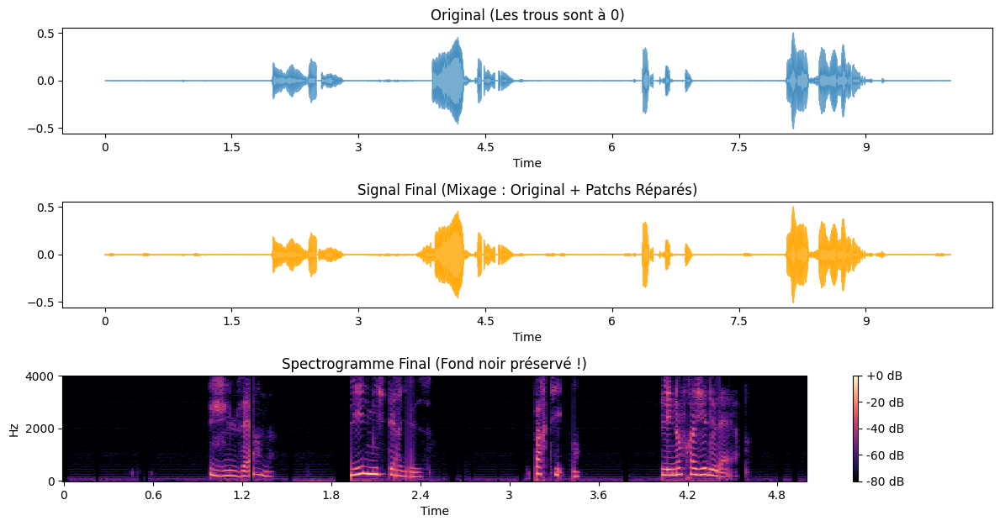

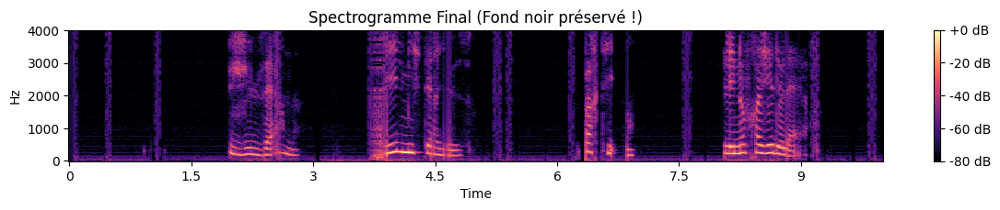

Chirurgie audio : Remplacement de 22 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav


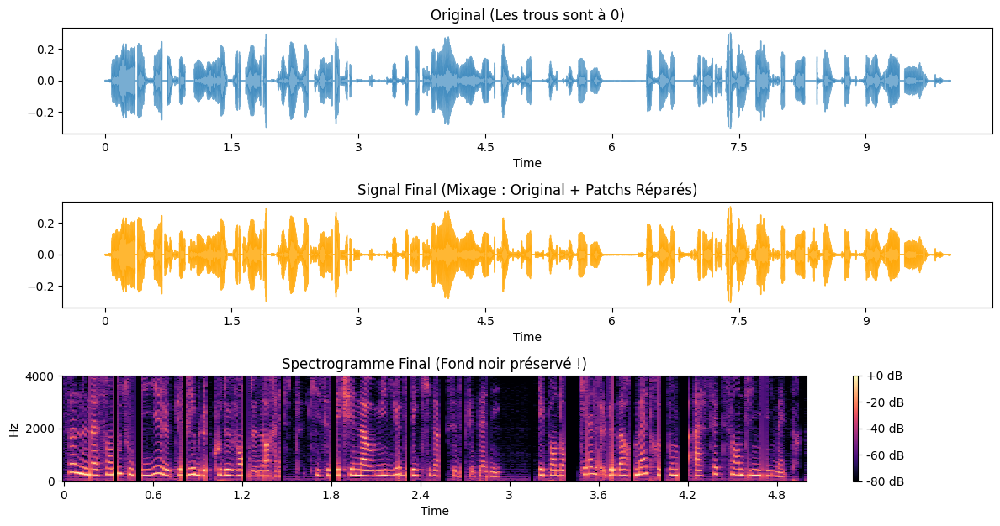

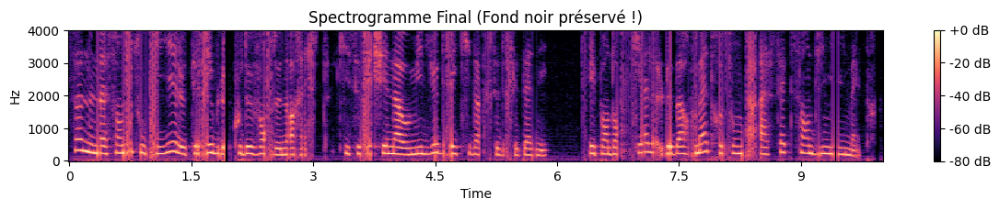

Chirurgie audio : Remplacement de 41 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav


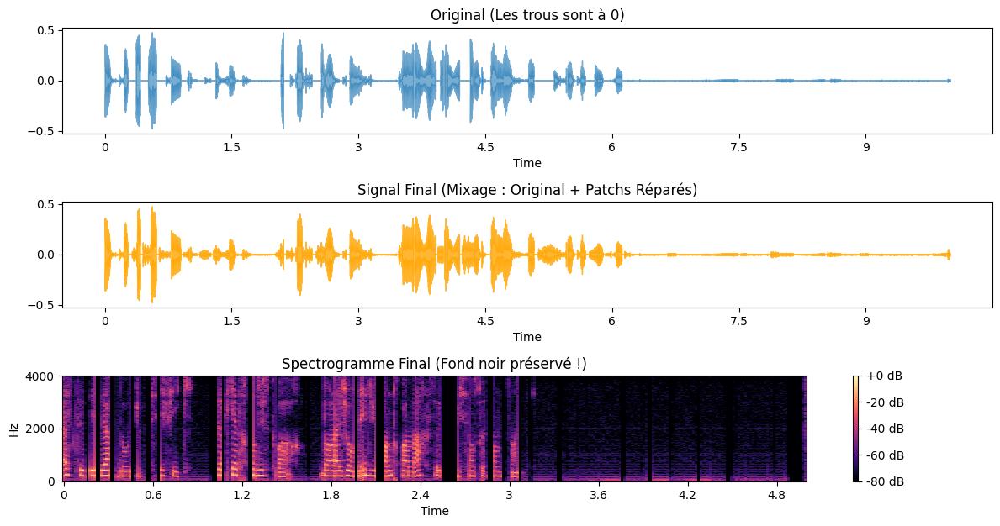

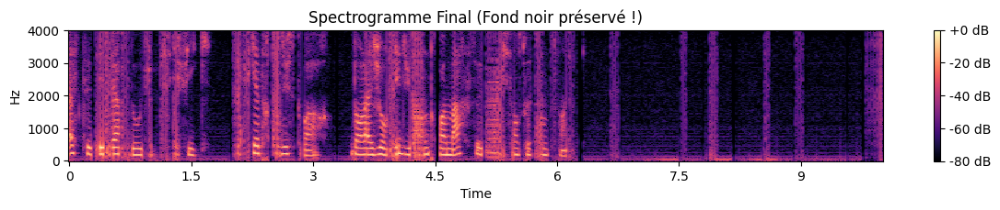

Chirurgie audio : Remplacement de 35 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav


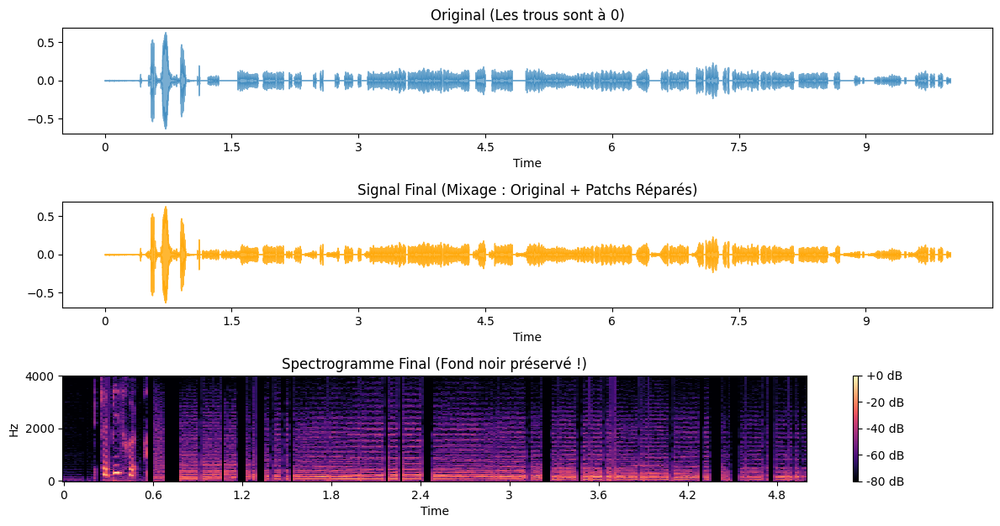

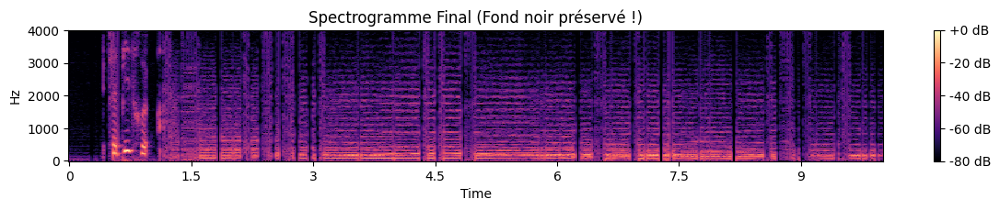

Chirurgie audio : Remplacement de 53 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav


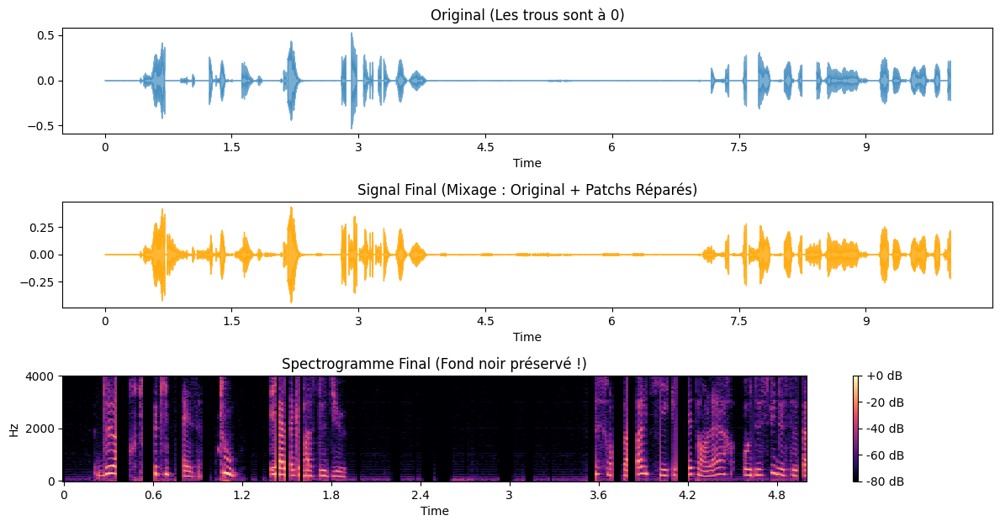

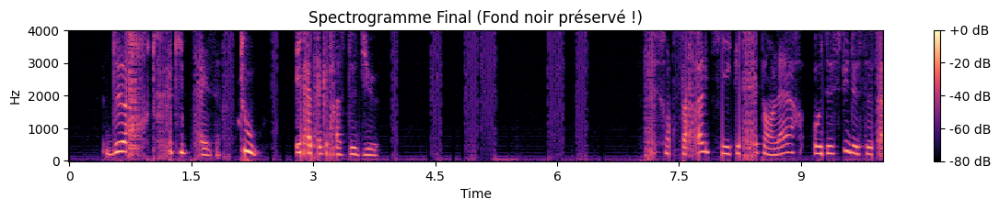

Chirurgie audio : Remplacement de 30 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav


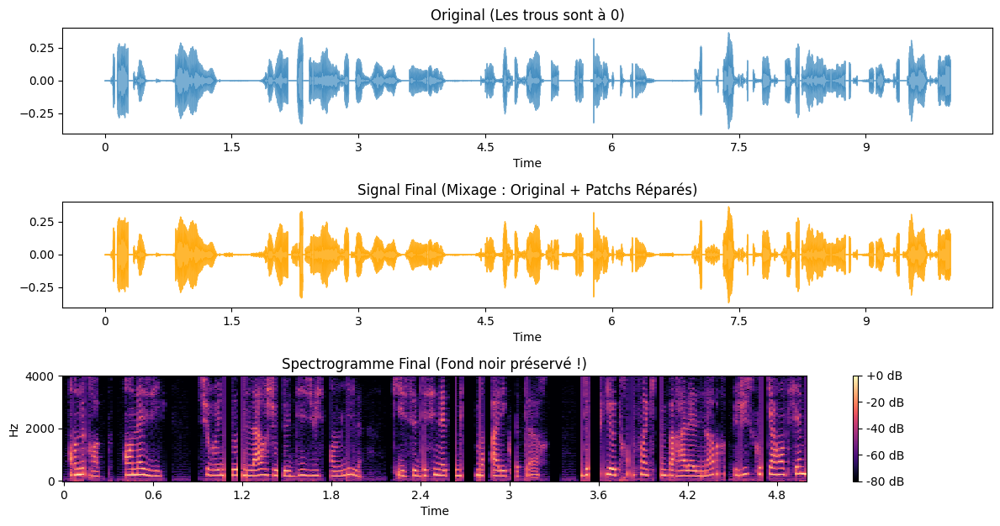

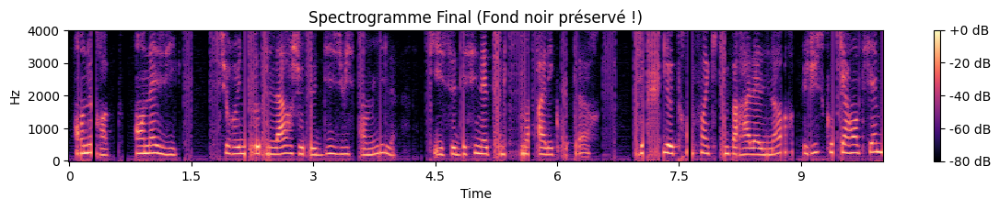

Chirurgie audio : Remplacement de 43 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav


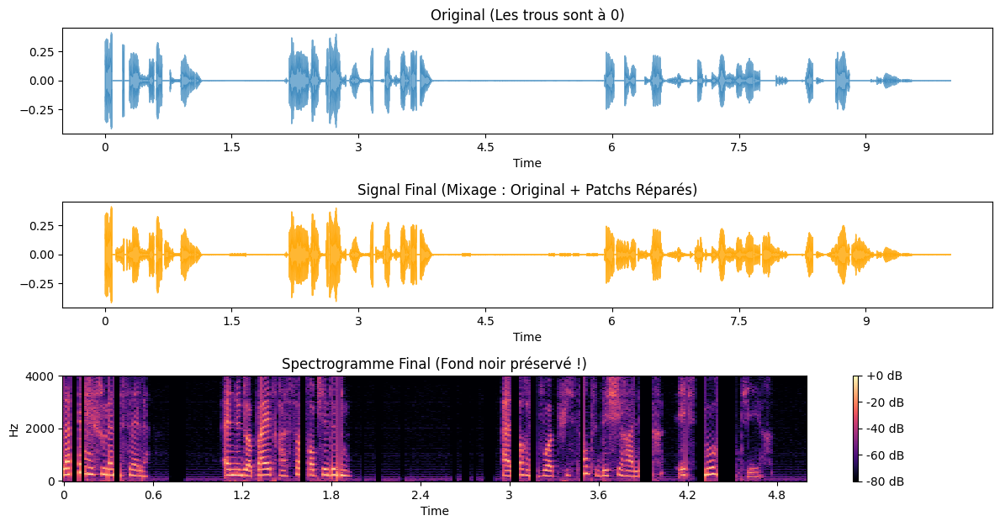

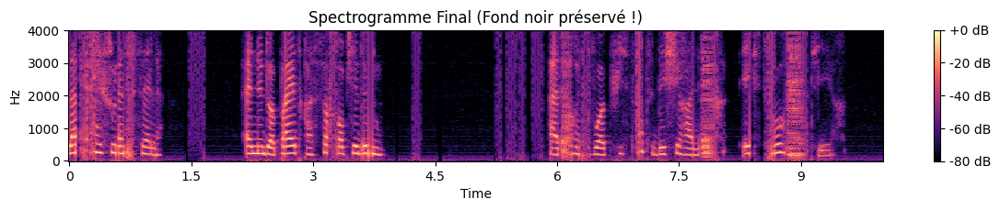

Chirurgie audio : Remplacement de 41 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav


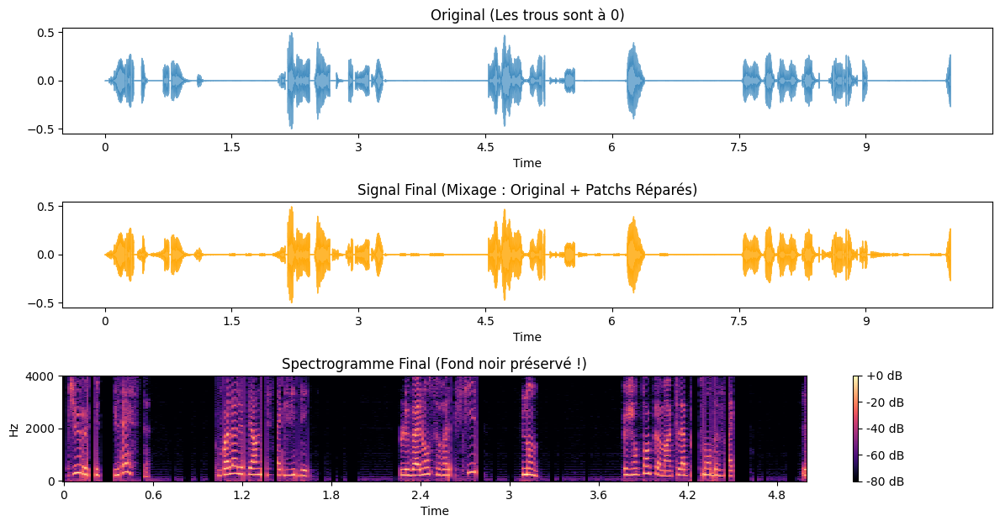

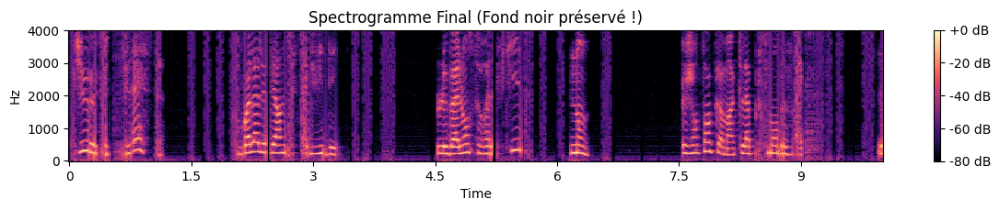

Chirurgie audio : Remplacement de 53 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav


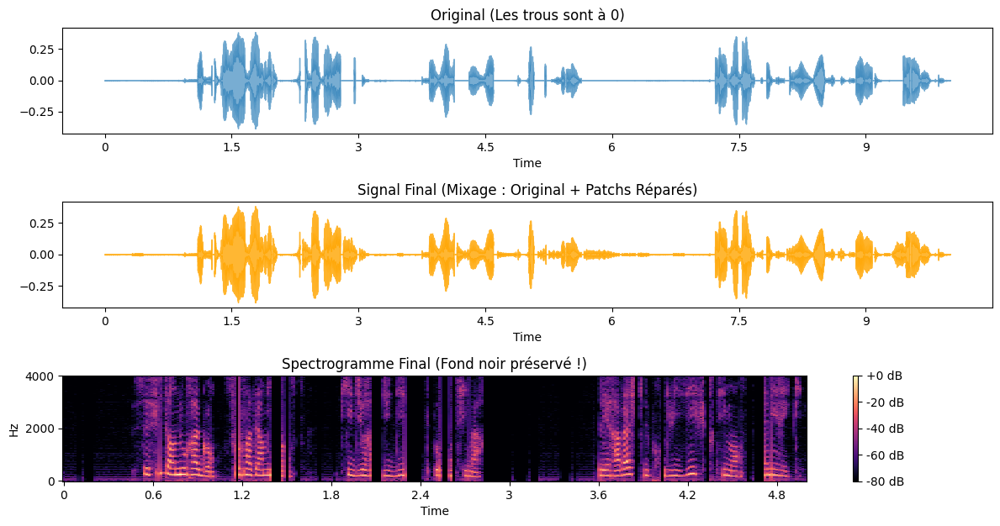

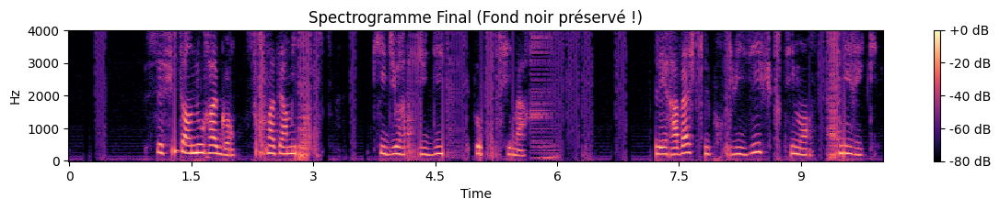

Chirurgie audio : Remplacement de 42 frames...
Fichier mixé sauvegardé : /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav


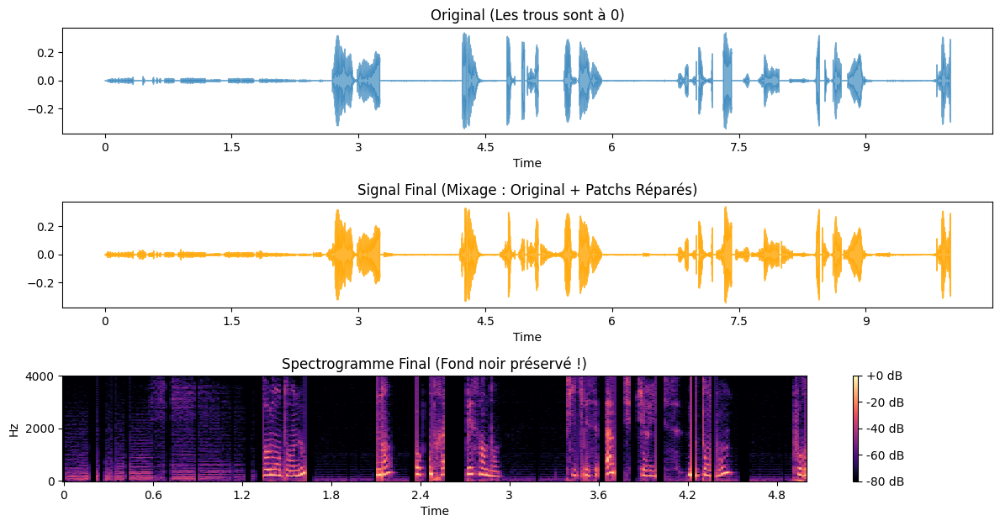

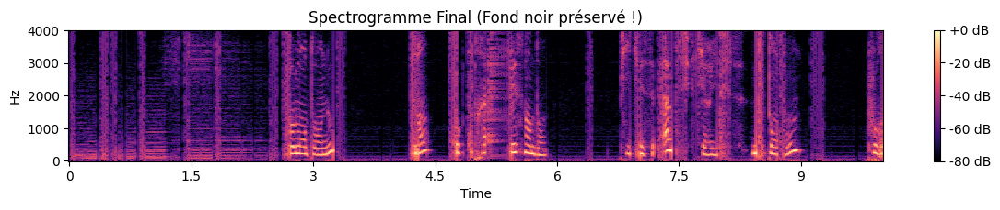

In [54]:
import os
import numpy as np
import librosa
import librosa.display
import soundfile as sf
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

def restoration_surgical_time_domain(input_path, output_path, sr=8000, n_mels=128):
    """
    1. Génère une version réparée complète (mais dégradée globalement).
    2. Utilise le signal original pour tout, sauf les trous.
    3. Remplace chirurgicalement les trous par le signal réparé.
    """

    # 1. Chargement Original
    y_orig, sr = librosa.load(input_path, sr=sr)

    # Paramètres STFT
    n_fft = 512
    hop_length = 256

    # 2. Création de la version réparée (processus identique au précédent)
    stft_matrix = librosa.stft(y_orig, n_fft=n_fft, hop_length=hop_length)
    S_linear = np.abs(stft_matrix)

    # Détection des trous (Masque sur les frames)
    # On considère un trou si l'énergie est < 0.5% du max
    energy_profile = np.max(S_linear, axis=0)
    if np.max(energy_profile) > 0:
        energy_profile_norm = energy_profile / np.max(energy_profile)
    else:
        energy_profile_norm = energy_profile

    mask_frames = energy_profile_norm < 0.00005 # True si c'est un trou

    # --- PROCESSUS DE RÉPARATION (Mel + Spline + dB) ---
    mel_basis = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=n_mels)
    S_mel = np.dot(mel_basis, S_linear)
    S_mel_db = librosa.power_to_db(S_mel**2, ref=np.max)

    # Interpolation Spline
    all_indices = np.arange(S_mel_db.shape[1])
    known_indices = all_indices[~mask_frames]
    missing_indices = all_indices[mask_frames]

    S_mel_db_fixed = S_mel_db.copy()

    # Si pas de trou, on rend l'original
    if len(missing_indices) == 0:
        return y_orig, y_orig, sr

    print(f"Chirurgie audio : Remplacement de {len(missing_indices)} frames...")

    for i in range(n_mels):
        values_known = S_mel_db[i, known_indices]
        if len(known_indices) > 3:
            try:
                f = interp1d(known_indices, values_known, kind='cubic',
                             bounds_error=False, fill_value=-100)
                # On remplit et on clip pour éviter les explosions
                fixed_vals = np.clip(f(missing_indices), -100, 0)
                S_mel_db_fixed[i, missing_indices] = fixed_vals
            except:
                pass

    # Inversion complète vers Time Domain
    S_mel_fixed = librosa.db_to_power(S_mel_db_fixed)
    S_mel_fixed = np.sqrt(S_mel_fixed)
    S_linear_approx = librosa.feature.inverse.mel_to_stft(S_mel_fixed, sr=sr, n_fft=n_fft)
    y_repaired_full = librosa.griffinlim(S_linear_approx, n_iter=32, hop_length=hop_length, win_length=n_fft)

    # --- ETAPE CLÉ : LE MIXAGE TEMPOREL ---

    # 1. On s'assure que les deux signaux ont exactement la même taille
    # (Griffin-Lim peut parfois changer la longueur de quelques échantillons)
    y_repaired_full = librosa.util.fix_length(y_repaired_full, size=len(y_orig))

    # 2. On convertit le masque "Frames" (STFT) en masque "Samples" (Temps)
    # Cela nous dit quels échantillons précis sont dans les trous
    mask_samples = np.zeros(len(y_orig), dtype=bool)

    frames_indices = np.where(mask_frames)[0]
    # Conversion frame -> sample indices
    sample_indices = librosa.frames_to_samples(frames_indices, hop_length=hop_length)

    # On élargit un peu le masque échantillon pour couvrir la fenêtre FFT complète (n_fft)
    for start_sample in sample_indices:
        end_sample = min(start_sample + n_fft, len(y_orig))
        mask_samples[start_sample : end_sample] = True

    # 3. LE MIXAGE FINAL
    # On prend l'original par défaut
    y_final = y_orig.copy()

    # On injecte le signal réparé UNIQUEMENT là où le masque est True
    # Pour adoucir la transition, on pourrait faire un cross-fade,
    # mais une copie directe est déjà bien meilleure que l'approche précédente.
    y_final[mask_samples] = y_repaired_full[mask_samples]

    # Sauvegarde
    if os.path.dirname(output_path):
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
    sf.write(output_path, y_final, sr)
    print(f"Fichier mixé sauvegardé : {output_path}")

    return y_orig, y_final, sr, S_linear, mask_samples

# --- EXÉCUTION ---
if not os.path.exists(dir_packet_loss): os.makedirs(dir_packet_loss, exist_ok=True)
files = [f for f in os.listdir(dir_packet_loss) if f.endswith('.wav')]

for file in files:
    target = file
    in_wav = os.path.join(dir_packet_loss, target)
    out_wav = os.path.join(base_path, "packet_loss","train_small_results", target)
    y_orig, y_final, sr, S_orig, mask_samp = restoration_surgical_time_domain(in_wav, out_wav)

    # --- VISUALISATION ---
    plt.figure(figsize=(12, 8))

    # 1. Original (Zoom sur une zone)
    plt.subplot(4, 1, 1)
    librosa.display.waveshow(y_orig, sr=sr, alpha=0.6)
    plt.title("Original (Les trous sont à 0)")

    # 2. Signal Final (Mixé)
    plt.subplot(4, 1, 2)
    librosa.display.waveshow(y_final, sr=sr, color='orange', alpha=0.8)
    plt.title("Signal Final (Mixage : Original + Patchs Réparés)")

    # 3. Spectrogramme Final (Doit être NOIR là où c'était violet avant)


    plt.subplot(4, 1, 3)
    librosa.display.specshow(librosa.amplitude_to_db(S_orig, ref=np.max),
                             sr=sr, hop_length=128, x_axis='time', y_axis='hz')
    plt.title("Spectrogramme Final Origine")
    plt.colorbar(format='%+2.0f dB')

    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(12, 8))

    # 1. Original (Zoom sur une zone)
    plt.subplot(4, 1, 1)
    S_final = np.abs(librosa.stft(y_final, n_fft=512, hop_length=128))
    librosa.display.specshow(librosa.amplitude_to_db(S_final, ref=np.max),
                             sr=sr, hop_length=128, x_axis='time', y_axis='hz')
    plt.title("Spectrogramme Final (Fond noir préservé !)")
    plt.colorbar(format='%+2.0f dB')

    plt.tight_layout()
    plt.show()

Detected 14981 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav


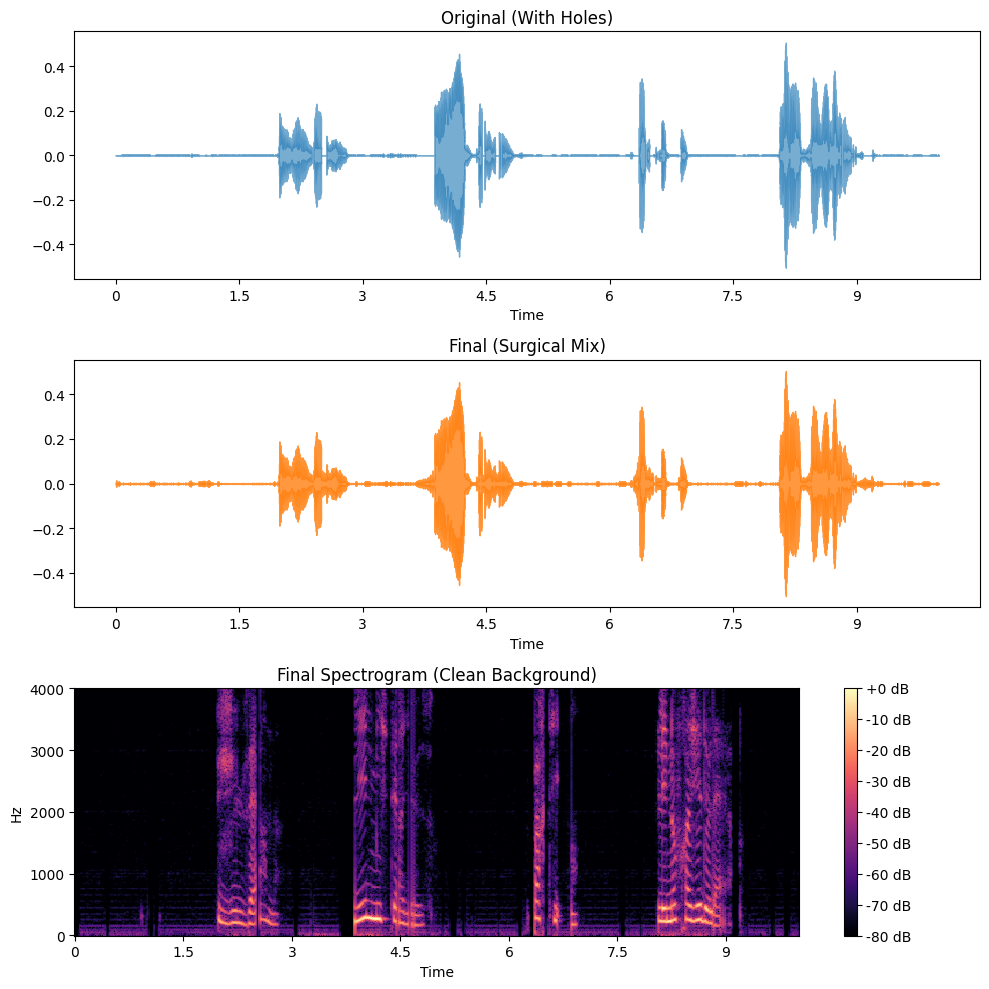

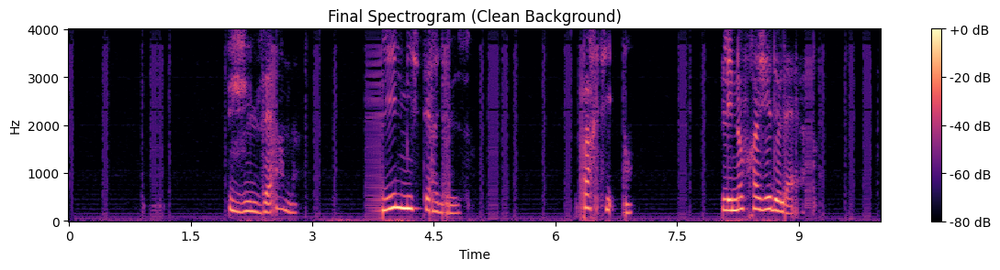

Detected 17153 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav


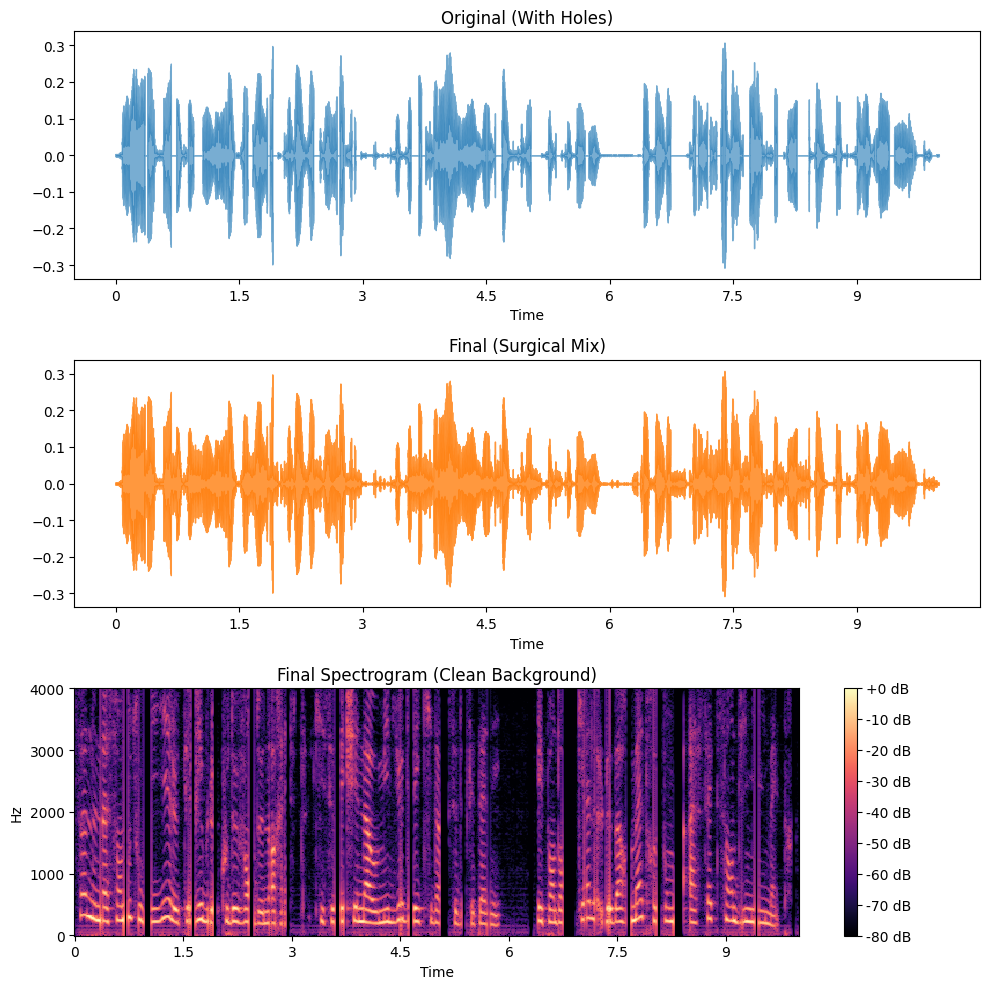

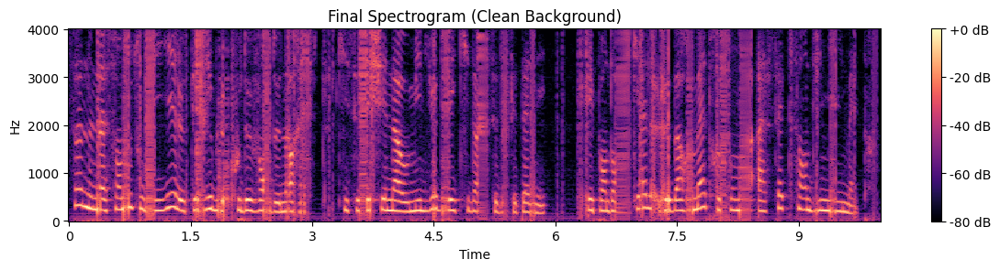

Detected 23424 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav


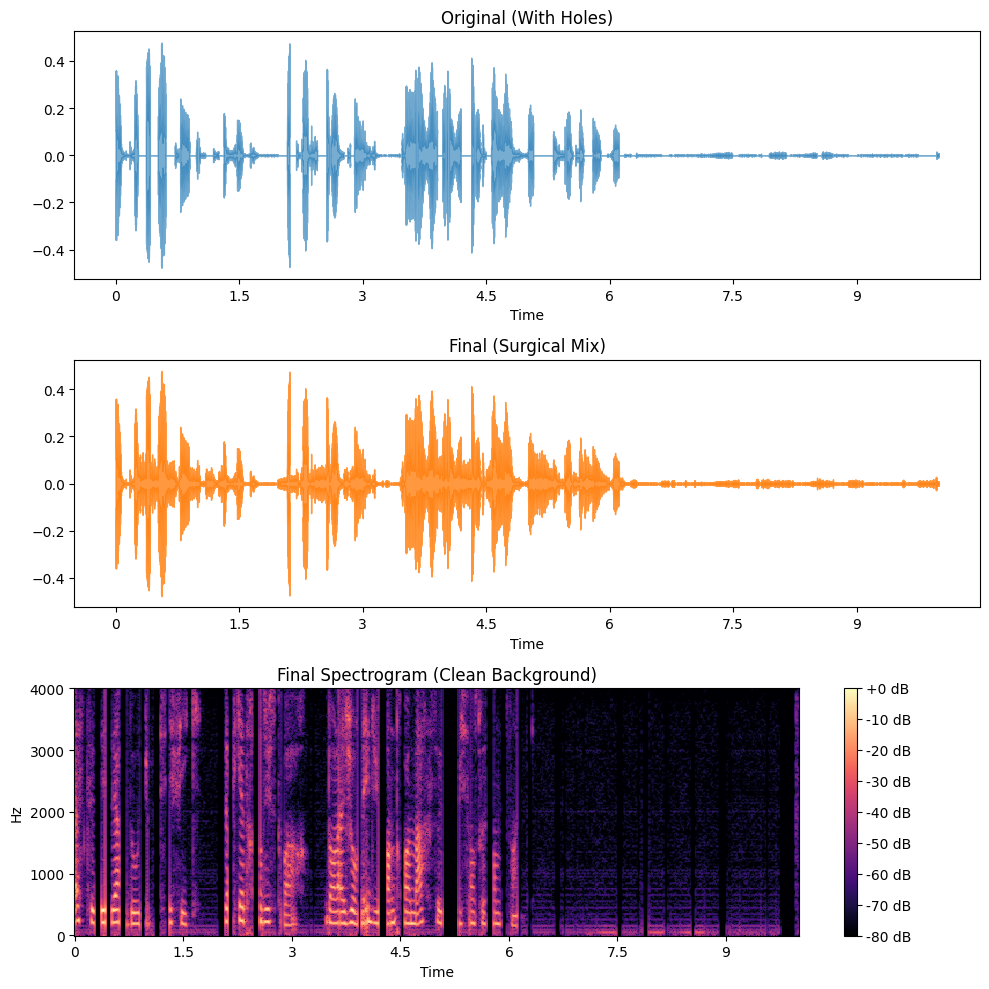

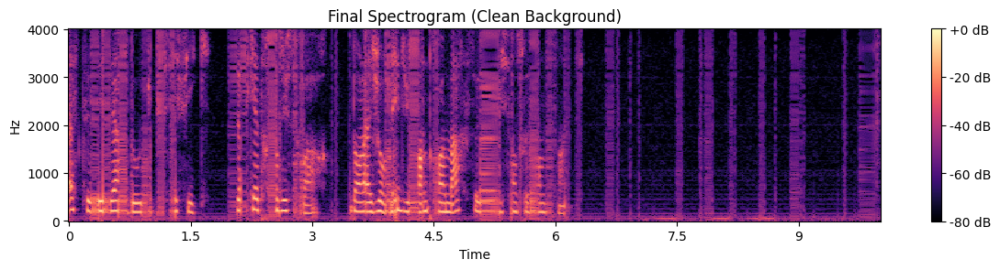

Detected 23936 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav


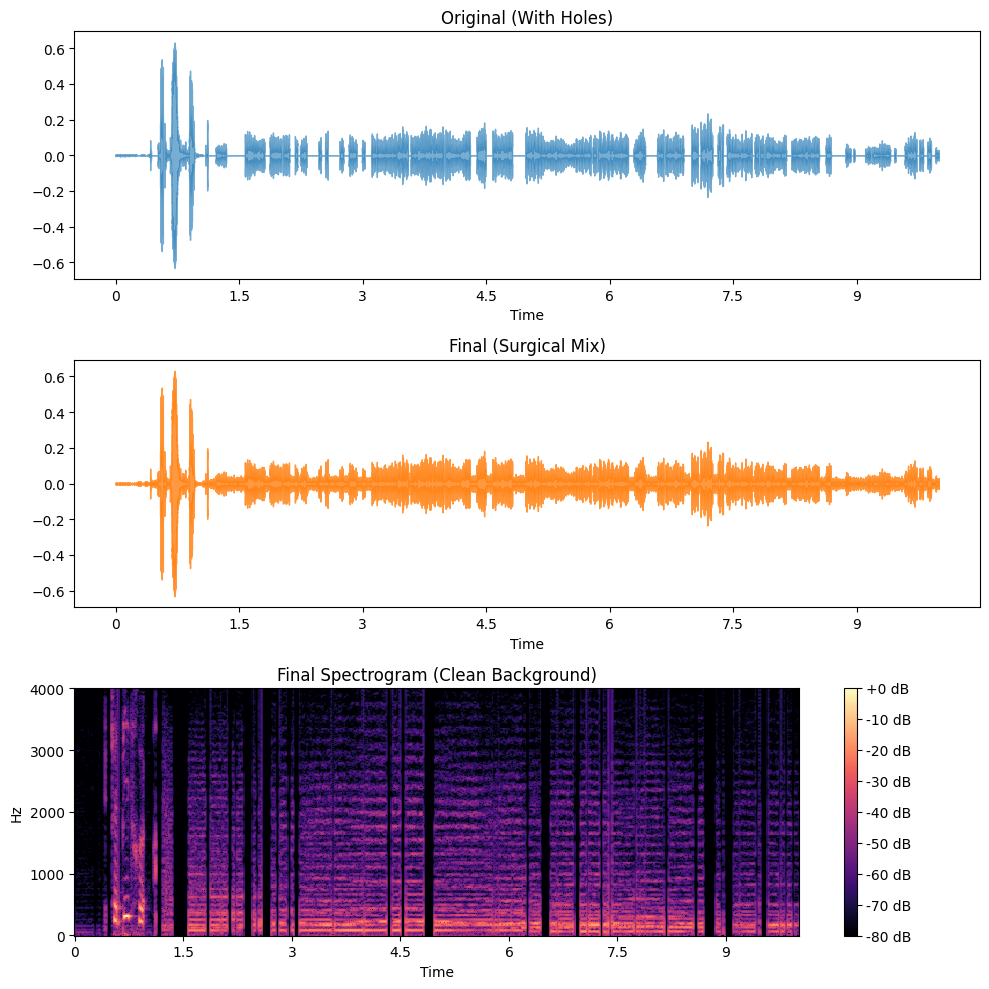

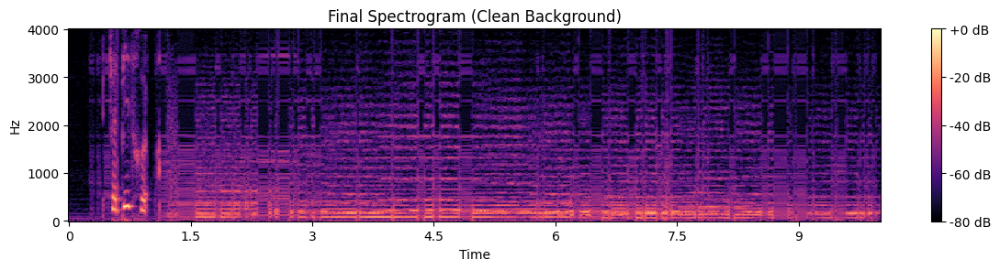

Detected 26497 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav


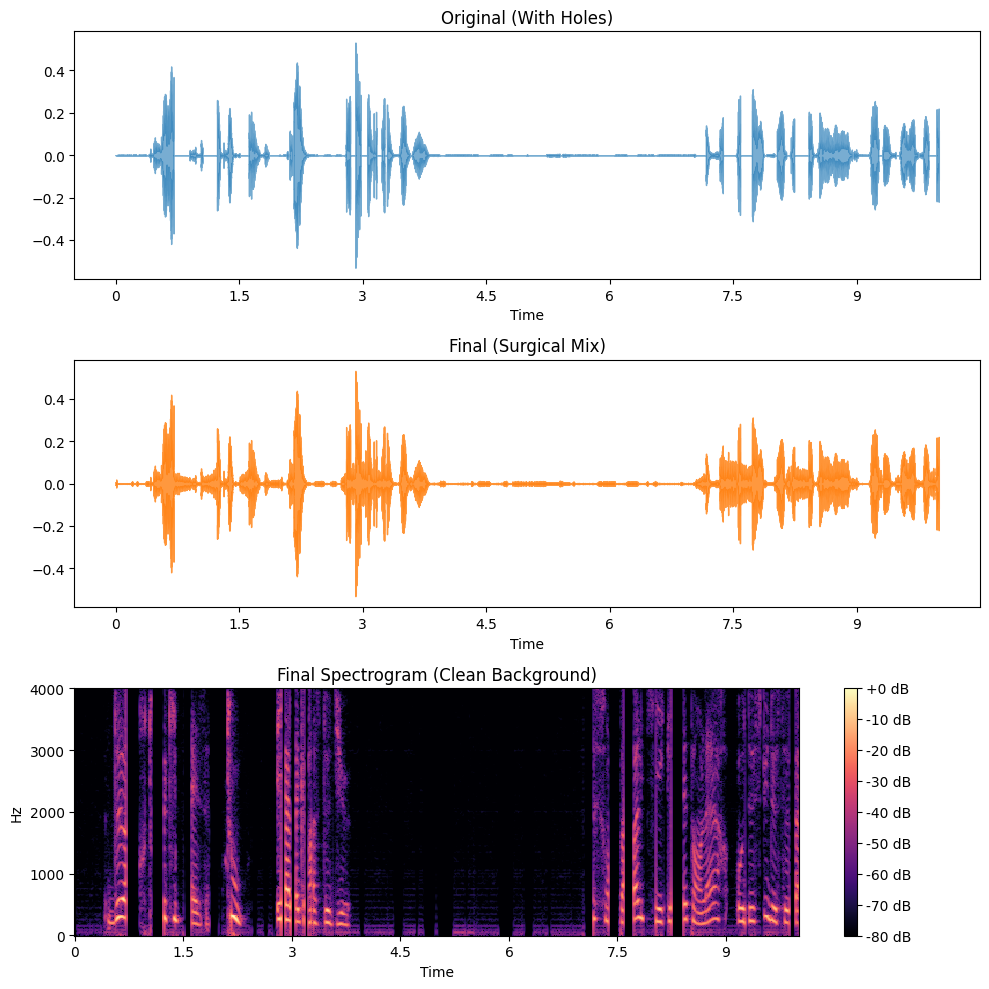

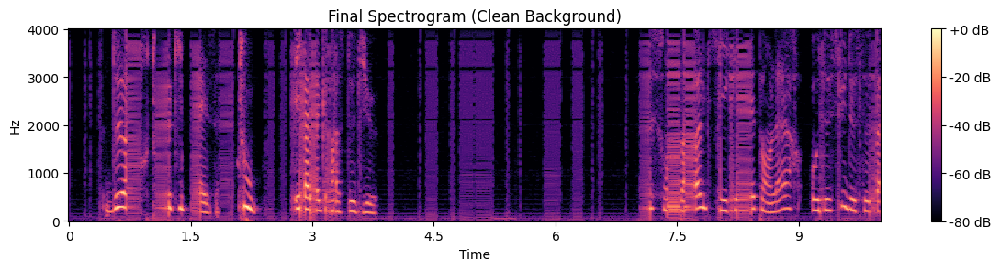

Detected 20608 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav


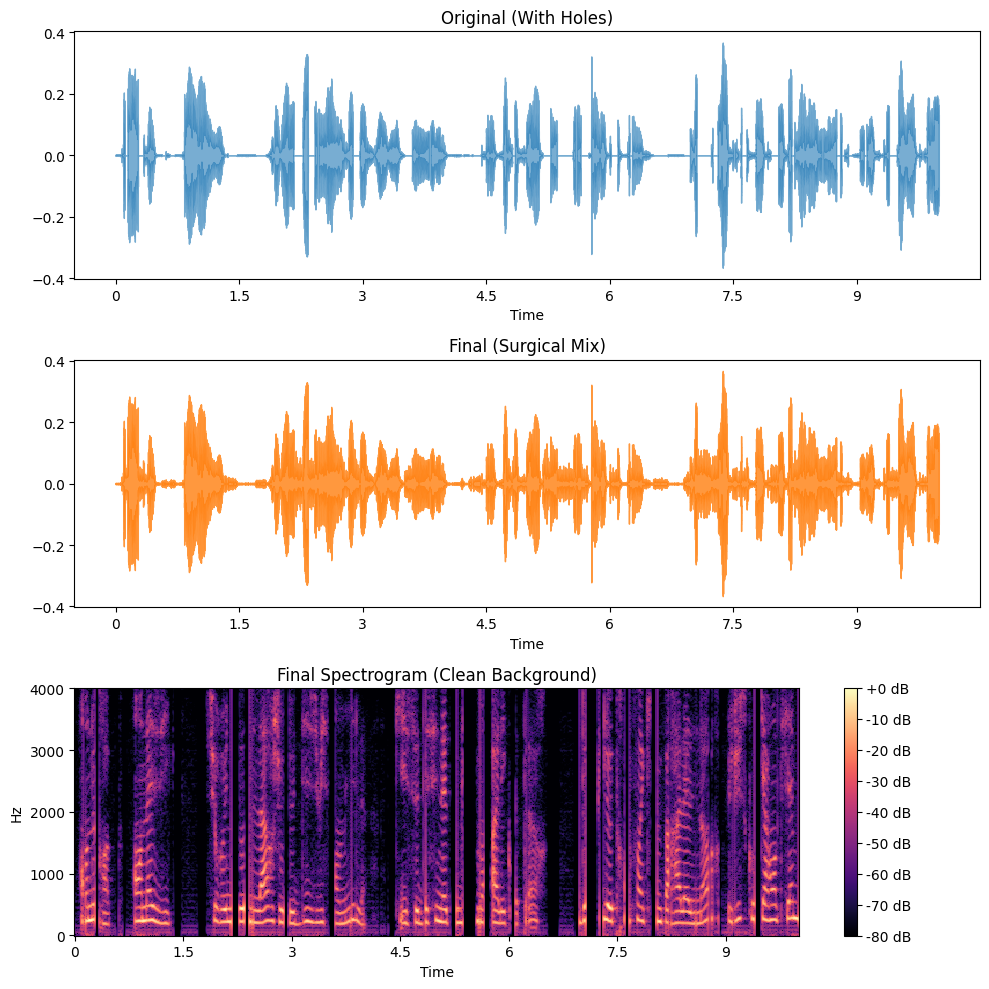

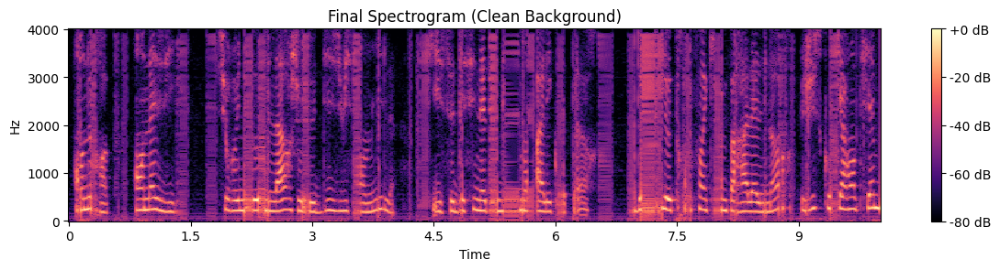

Detected 20481 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav


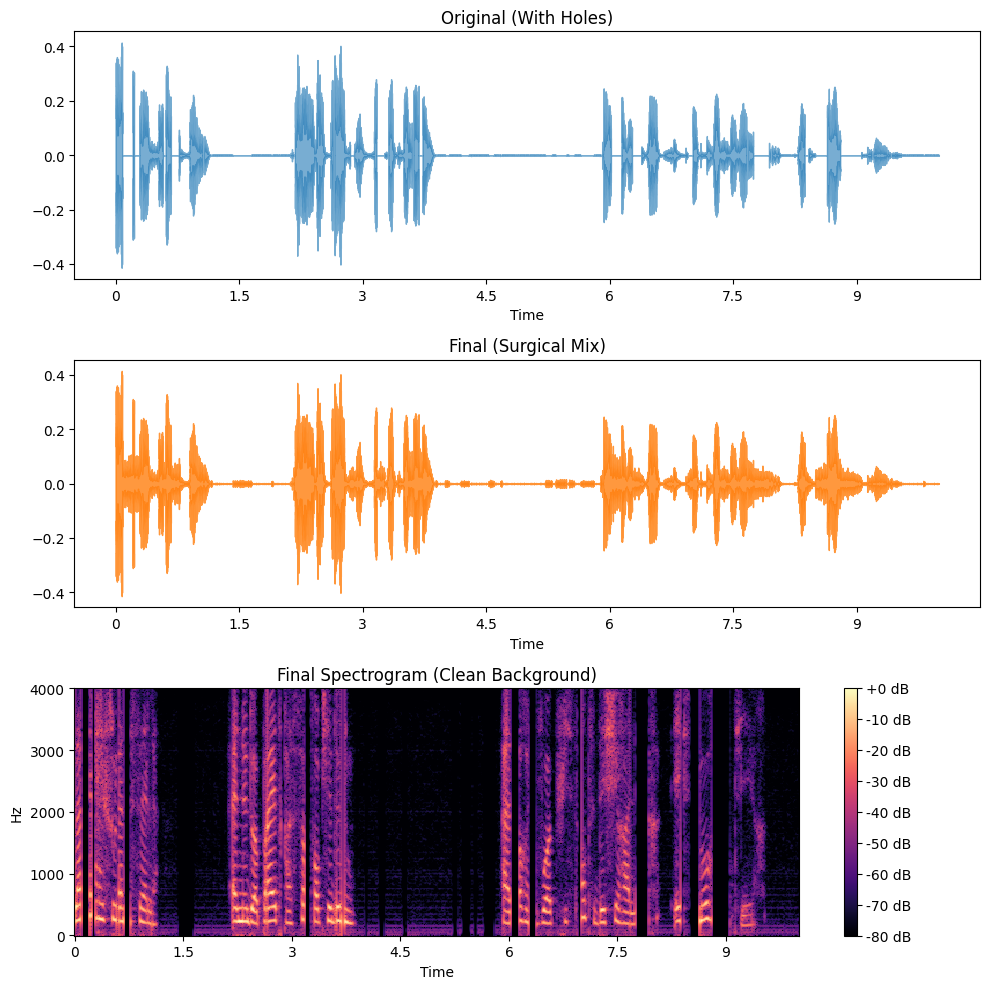

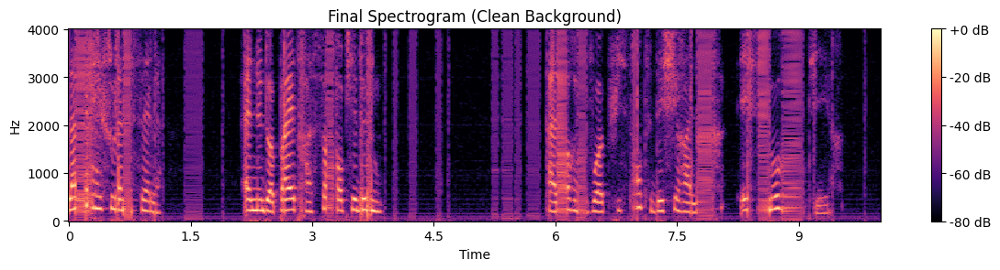

Detected 24960 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav


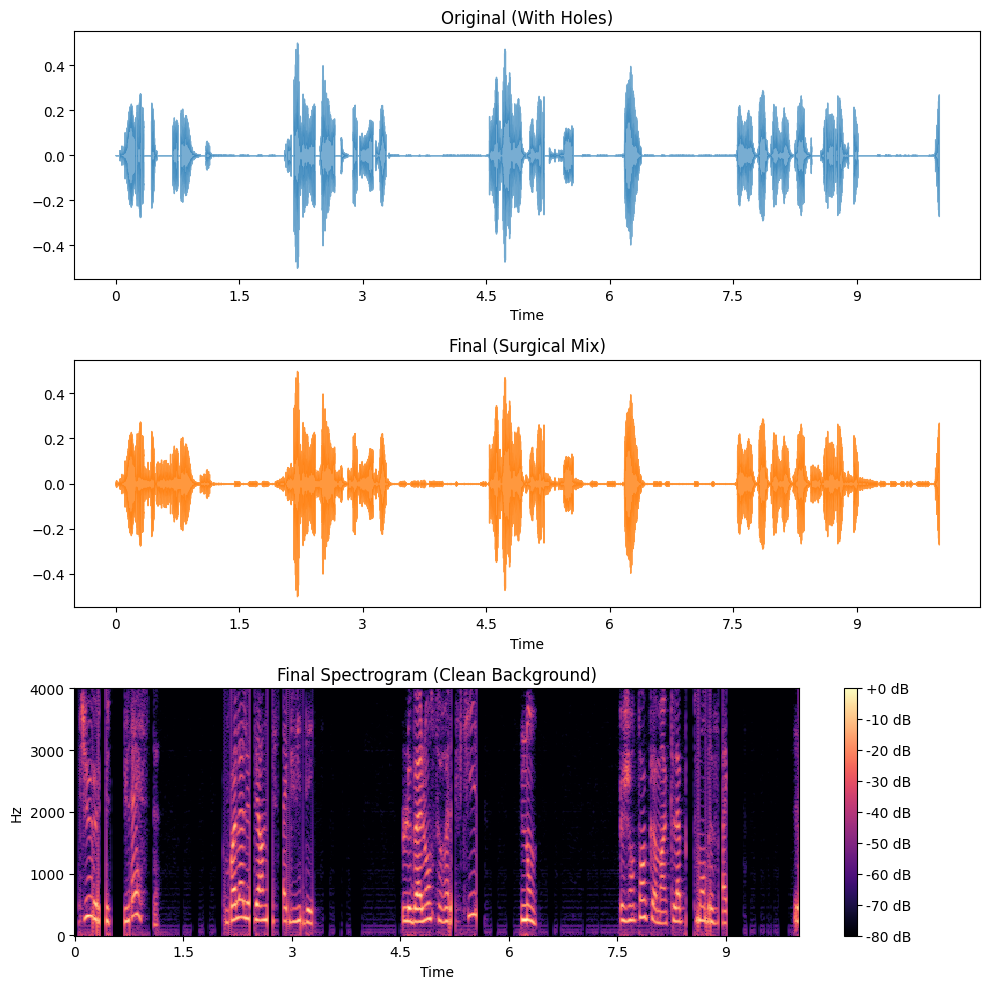

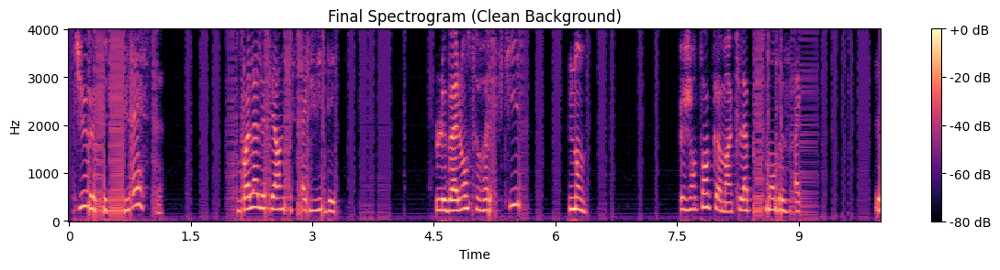

Detected 25217 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav


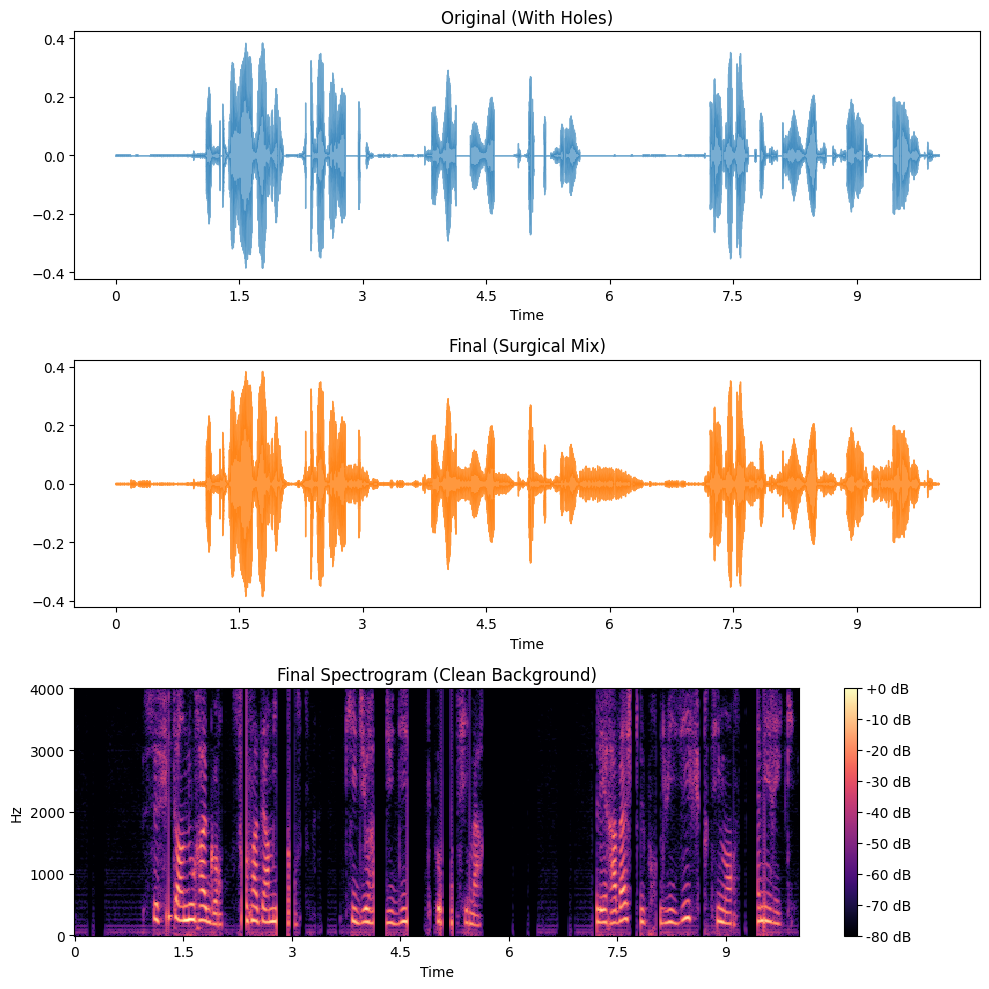

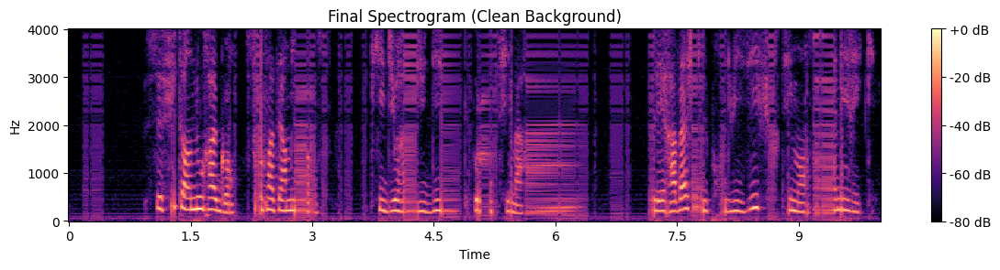

Detected 22529 missing samples.
Saved: /content/drive/MyDrive/Signal_MVA/data/packet_loss/train_small_results/Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav


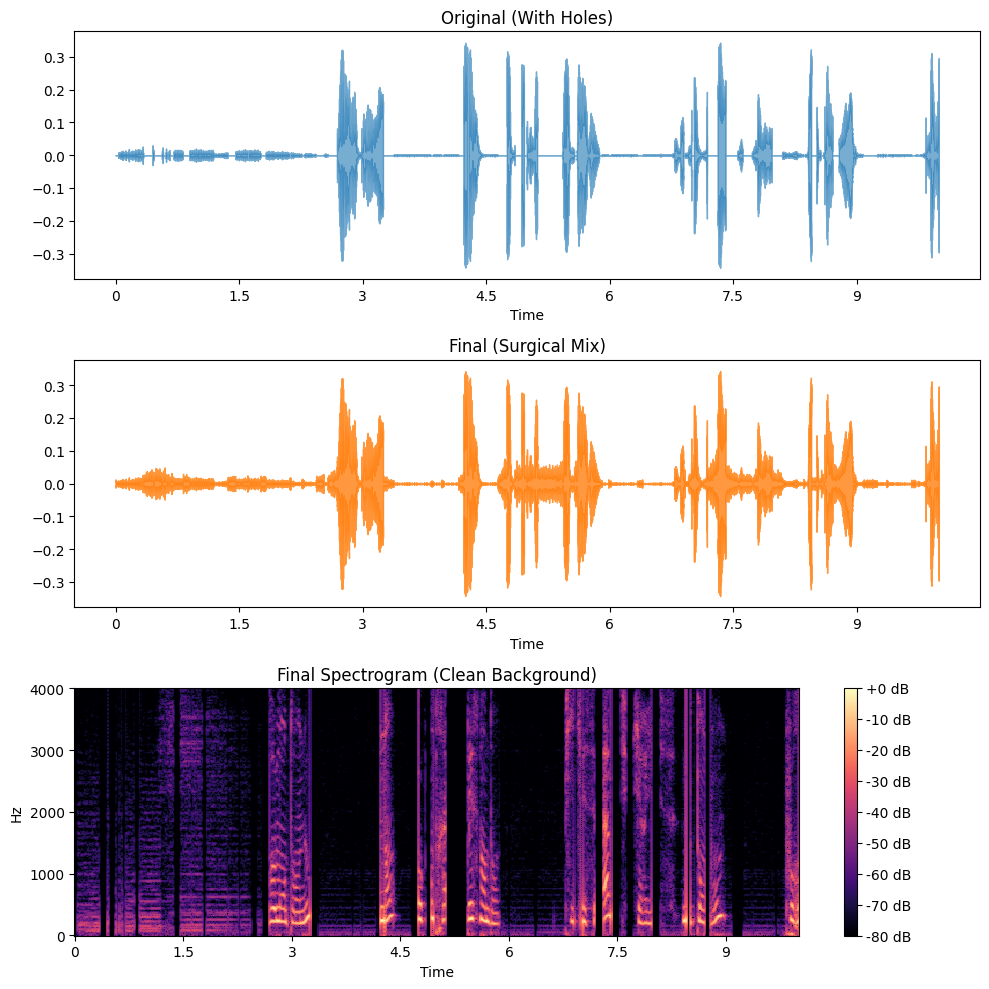

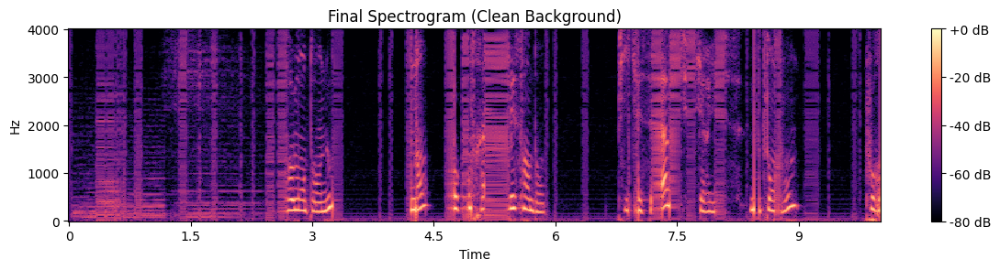

In [81]:
import os
import numpy as np
import librosa
import librosa.display
import soundfile as sf
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.signal import medfilt
from scipy.ndimage import binary_opening # NEW: For cleaning the mask

def detect_holes_time(y, sr, threshold=0.0005, min_hole_ms=5):
    """
    Detects holes directly on the waveform.
    Ignores natural zero-crossings (short silences).
    """
    # 1. Naive detection (Silence)
    mask_naive = np.abs(y) < threshold

    # 2. Structure element: Defines the minimum length of a "real" hole
    # We convert ms to samples
    min_samples = int(sr * (min_hole_ms / 1000))
    structure = np.ones(min_samples)

    # 3. Binary Opening: Erodes small dots, dilates back real holes
    mask_clean = binary_opening(mask_naive, structure=structure)

    return mask_clean

def restoration_surgical_time_domain(input_path, output_path, sr=8000, n_mels=128):

    # 1. Load Original
    y_orig, sr = librosa.load(input_path, sr=sr)

    # --- CHANGE 1: Time Domain Detection ---
    # We detect holes BEFORE doing any math.
    # Threshold 0.0005 is standard for digital silence/packet loss.
    mask_time = detect_holes_time(y_orig, sr, threshold=0.00005)

    if not np.any(mask_time):
        print("No holes detected.")
        return y_orig, y_orig, sr, None, mask_time

    print(f"Detected {np.sum(mask_time)} missing samples.")

    # 2. STFT Parameters
    n_fft = 512
    hop_length = 128 # CHANGED: 128 gives better resolution than 256

    # 3. Create Repaired Version (The "Engine")
    stft_matrix = librosa.stft(y_orig, n_fft=n_fft, hop_length=hop_length)
    S_linear = np.abs(stft_matrix)

    # --- CHANGE 2: Map Time Mask to Frame Mask ---
    # We need to know which columns in the spectrogram correspond to the time holes
    # .any(axis=0) means: "If a frame contains any hole samples, mark it as a hole"
    mask_frames = librosa.util.frame(mask_time, frame_length=n_fft, hop_length=hop_length).any(axis=0)

    # Safety pad if dimensions mismatch slightly due to padding
    if len(mask_frames) < S_linear.shape[1]:
        mask_frames = np.pad(mask_frames, (0, S_linear.shape[1] - len(mask_frames)))
    else:
        mask_frames = mask_frames[:S_linear.shape[1]]

  # On considère un trou si l'énergie est < 0.5% du max

    # 4. Log-Mel Transformation
    mel_basis = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=n_mels)
    S_mel = np.dot(mel_basis, S_linear)
    S_mel_db = librosa.power_to_db(S_mel**2, ref=np.max)

    # 5. Spline Interpolation
    all_indices = np.arange(S_mel_db.shape[1])
    known_indices = all_indices[~mask_frames]
    missing_indices = all_indices[mask_frames]

    S_mel_db_fixed = S_mel_db.copy()

# Seuil de silence en dB (ajustable)
    # Si les voisins sont en dessous de -50dB, on considère que c'est du silence
    silence_threshold_db = -40.0

    for i in range(n_mels):
        # On récupère les voisins connus
        values_known = S_mel_db[i, known_indices]

        if len(known_indices) > 3:
            # CHECK INTELLIGENT : Est-ce que cette fréquence est globalement silencieuse ?
            # On regarde l'énergie moyenne des points connus
            local_energy = np.max(values_known)

            # CAS 1 : C'est du silence (bruit de fond) -> On ne fait PAS de spline
            if local_energy < silence_threshold_db:
                # On force le silence absolu (-100 dB) dans le trou
                S_mel_db_fixed[i, missing_indices] = -100.0

            # CAS 2 : C'est de la voix active -> On fait la spline
            else:
                try:
                    # On force le silence aux extrémités (fill_value=-100)

                    values_smoothed = medfilt(values_known, kernel_size=3)

                    # On utilise ces valeurs lissées pour calculer la courbe
                    f = interp1d(known_indices, values_smoothed, kind='cubic',
                                bounds_error=False, fill_value=-80)
                    predicted = f(missing_indices)

                    # Correction anti-bruit supplémentaire :
                    # On s'assure que la prédiction ne dépasse pas le volume max des voisins
                    # Cela empêche la courbe de sauter plus haut que le signal réel
                    max_neighbor = np.max(values_known)
                    predicted = np.clip(predicted, -100, max_neighbor)

                    S_mel_db_fixed[i, missing_indices] = predicted
                except:
                    pass

    # 6. Inversion to Time Domain
    S_mel_fixed = librosa.db_to_power(S_mel_db_fixed)
    S_mel_fixed = np.sqrt(S_mel_fixed)
    S_linear_approx = librosa.feature.inverse.mel_to_stft(S_mel_fixed, sr=sr, n_fft=n_fft)
    y_repaired_full = librosa.griffinlim(S_linear_approx, n_iter=32, hop_length=hop_length, win_length=n_fft)

    # --- CHANGE 3: Surgical Mixing using TIME mask ---

    # Ensure lengths match exactly
    y_repaired_full = librosa.util.fix_length(y_repaired_full, size=len(y_orig))

    y_final = y_orig.copy()

    # CRITICAL: We use the precise 'mask_time' we calculated at the very beginning
    # We paste the repaired audio ONLY into the holes.
    y_final[mask_time] = y_repaired_full[mask_time]

    # Save
    if os.path.dirname(output_path):
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
    sf.write(output_path, y_final, sr)
    print(f"Saved: {output_path}")

    return y_orig, y_final, sr, S_linear, mask_time

# --- EXECUTION ---

if not os.path.exists(dir_packet_loss): os.makedirs(dir_packet_loss, exist_ok=True)
files = [f for f in os.listdir(dir_packet_loss) if f.endswith('.wav')]

for file in files:
    target = file
    in_wav = os.path.join(dir_packet_loss, target)
    out_wav = os.path.join(base_path, "packet_loss","train_small_results", target)

    y_orig, y_final, sr, S_orig, mask_time = restoration_surgical_time_domain(in_wav, out_wav)

    # --- CLEANER VISUALIZATION ---
    plt.figure(figsize=(10, 10))

    # 1. Original Waveform
    plt.subplot(3, 1, 1)
    librosa.display.waveshow(y_orig, sr=sr, alpha=0.6)
    plt.title("Original (With Holes)")

    # 2. Final Waveform
    plt.subplot(3, 1, 2)
    librosa.display.waveshow(y_final, sr=sr, color='#ff7f0e', alpha=0.8)
    plt.title("Final (Surgical Mix)")

    # 3. Final Spectrogram
    plt.subplot(3, 1, 3)
    S_final = np.abs(librosa.stft(y_final, n_fft=512, hop_length=128))
    librosa.display.specshow(librosa.amplitude_to_db(S_orig, ref=np.max),
                             sr=sr, hop_length=128, x_axis='time', y_axis='hz')
    plt.title("Final Spectrogram (Clean Background)")
    plt.colorbar(format='%+2.0f dB')

    plt.tight_layout()
    plt.show()


    plt.figure(figsize=(12, 8))

    # 1. Original (Zoom sur une zone)
    plt.subplot(3, 1, 1)
    S_final = np.abs(librosa.stft(y_final, n_fft=512, hop_length=128))
    librosa.display.specshow(librosa.amplitude_to_db(S_final, ref=np.max),
                             sr=sr, hop_length=128, x_axis='time', y_axis='hz')
    plt.title("Final Spectrogram (Clean Background)")
    plt.colorbar(format='%+2.0f dB')

    plt.tight_layout()
    plt.show()

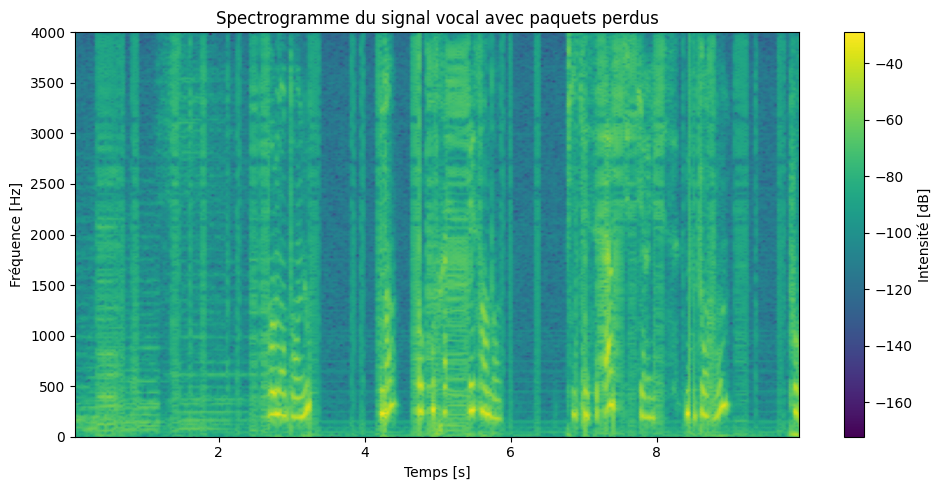

/tmp/ipython-input-171807449.py:21: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t, f, 10 * np.log10(S_origin), shading='gouraud')


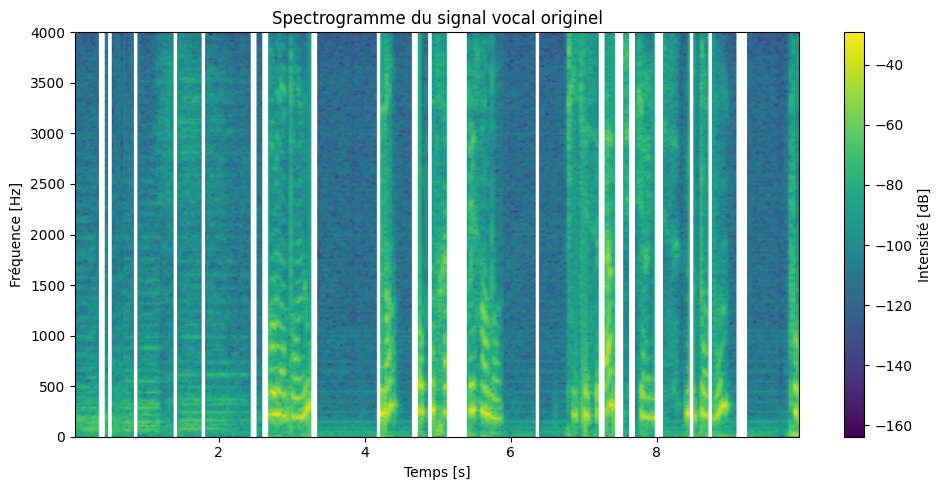

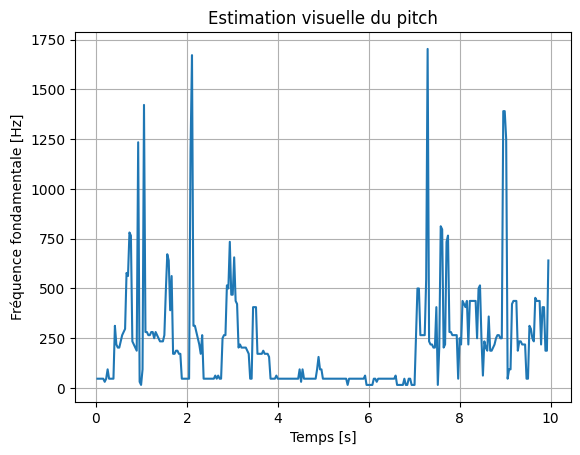

In [69]:
import scipy

f, t, Sxx_empty = scipy.signal.spectrogram(y_final, fs=8000, nperseg=512, noverlap=256)


# --- Affichage ---
plt.figure(figsize=(10, 5))
plt.pcolormesh(t, f, 10 * np.log10(Sxx_empty), shading='gouraud')
plt.title("Spectrogramme du signal vocal avec paquets perdus")
plt.xlabel("Temps [s]")
plt.ylabel("Fréquence [Hz]")
plt.colorbar(label="Intensité [dB]")
plt.tight_layout()
plt.show()

f, t, S_origin = scipy.signal.spectrogram(y_orig, fs=8000, nperseg=512, noverlap=256)


# --- Affichage ---
plt.figure(figsize=(10, 5))
plt.pcolormesh(t, f, 10 * np.log10(S_origin), shading='gouraud')
plt.title("Spectrogramme du signal vocal originel")
plt.xlabel("Temps [s]")
plt.ylabel("Fréquence [Hz]")
plt.colorbar(label="Intensité [dB]")
plt.tight_layout()
plt.show()
pitch_estim = f[np.argmax(Sxx, axis=0)]

plt.plot(t, pitch_estim)
plt.title("Estimation visuelle du pitch")
plt.xlabel("Temps [s]")
plt.ylabel("Fréquence fondamentale [Hz]")
plt.grid(True)
plt.show()

In [19]:
!pip install pesq
!pip install pystoi

  Preparing metadata (setup.py) ... done
  Created wheel for pesq: filename=pesq-0.0.4-cp312-cp312-linux_x86_64.whl size=284125 sha256=8d2405f3d0099a8fde2e9ada2c6cf89f61c2d2ba42a674e98921dc58058ae634
  Stored in directory: /root/.cache/pip/wheels/9b/d4/a4/9cf3512534cd47ce4a036d1593ee4013f2bf7509e631a147a3
Successfully built pesq


In [82]:
import os
import numpy as np
import librosa
import pandas as pd
from pesq import pesq
from pystoi import stoi
from tqdm import tqdm # Pour la barre de progression (pip install tqdm)

def calculate_metrics(ref_path, est_path, sr=8000):
    """
    Calcule PESQ et STOI pour une paire de fichiers.
    """
    # 1. Chargement
    # On force le chargement à la même fréquence
    ref, _ = librosa.load(ref_path, sr=sr)
    est, _ = librosa.load(est_path, sr=sr)

    # 2. Alignement de longueur (Sécurité)
    # PESQ plante si les longueurs sont différentes
    min_len = min(len(ref), len(est))
    ref = ref[:min_len]
    est = est[:min_len]

    # 3. Calcul du STOI (Intelligibilité)
    # Retourne une valeur entre 0.0 et 1.0
    try:
        stoi_score = stoi(ref, est, sr, extended=False)
    except Exception as e:
        print(f"Erreur STOI sur {os.path.basename(ref_path)}: {e}")
        stoi_score = np.nan

    # 4. Calcul du PESQ (Qualité)
    # Mode 'nb' (Narrowband) car sr=8000Hz.
    # Si vous étiez à 16000Hz, il faudrait 'wb' (Wideband).
    try:
        # PESQ nécessite parfois un volume normalisé, mais la lib le gère souvent.
        pesq_score = pesq(sr, ref, est, 'nb')
    except Exception as e:
        # PESQ peut échouer si le signal est trop court (<0.25s) ou silence pur
        # print(f"Erreur PESQ sur {os.path.basename(ref_path)}: {e}")
        pesq_score = np.nan

    return pesq_score, stoi_score

def evaluate_test_set(original_dir, repaired_dir, sr=8000):
    """
    Parcourt le dossier de test et calcule la moyenne des scores.
    """
    results = []

    # On liste les fichiers réparés
    files = [f for f in os.listdir(repaired_dir) if f.endswith('.wav')]

    if not files:
        print("Aucun fichier trouvé dans le dossier réparé.")
        return

    print(f"Évaluation de {len(files)} fichiers...")

    for filename in tqdm(files):
        path_est = os.path.join(repaired_dir, filename)

        # On suppose que le fichier original a le même nom
        # (Adaptez ici si vos noms diffèrent, ex: 'file_repaired.wav' vs 'file.wav')
        path_ref = os.path.join(original_dir, filename)

        if not os.path.exists(path_ref):
            print(f"Attention: Référence introuvable pour {filename}")
            continue

        # Calcul
        p_score, s_score = calculate_metrics(path_ref, path_est, sr)

        results.append({
            'filename': filename,
            'PESQ': p_score,
            'STOI': s_score
        })

    # Création d'un DataFrame pour l'analyse
    df = pd.DataFrame(results)

    # Affichage des moyennes
    print("\n--- RÉSULTATS GLOBAUX ---")
    print(f"Nombre de fichiers évalués : {len(df)}")
    print(f"PESQ Moyen : {df['PESQ'].mean():.3f}  (Max théorique: 4.5)")
    print(f"STOI Moyen : {df['STOI'].mean():.3f}  (Max théorique: 1.0)")

    return df

# --- EXEMPLE D'UTILISATION ---

# Dossier contenant les originaux PARFAITS (sans trous)
# Attention: Il faut comparer avec l'original SANS perte, pas celui avec les trous !
dir_ground_truth = dir_voice_origin

# Dossier contenant vos résultats (Mel + Spline + Mixage)
dir_repaired = os.path.join(base_path, "packet_loss","train_small_results")


# Si vous n'avez pas le dossier "clean", vous ne pouvez pas calculer de métriques justes.
# On compare toujours : (Signal Prédit) vs (Signal Réel sans défaut)

if os.path.exists(dir_ground_truth) and os.path.exists(dir_repaired):
    print('''--- empty signal ---''')
    df_results = evaluate_test_set(dir_ground_truth, dir_packet_loss, sr=8000)
    # Sauvegarder en CSV si besoin
    # df_results.to_csv("resultats_evaluation.csv", index=False)
    print('''---  Repaired signal ---''')
    df_results = evaluate_test_set(dir_ground_truth, dir_repaired, sr=8000)
    # Sauvegarder en CSV si besoin
    # df_results.to_csv("resultats_evaluation.csv", index=False)
else:
    print(dir_ground_truth,dir_repaired)
    print("Vérifiez vos chemins de dossiers.")

--- empty signal ---
Évaluation de 10 fichiers...


100%|██████████| 10/10 [00:03<00:00,  2.78it/s]



--- RÉSULTATS GLOBAUX ---
Nombre de fichiers évalués : 10
PESQ Moyen : 1.149  (Max théorique: 4.5)
STOI Moyen : 0.572  (Max théorique: 1.0)
---  Repaired signal ---
Évaluation de 10 fichiers...


100%|██████████| 10/10 [00:04<00:00,  2.46it/s]


--- RÉSULTATS GLOBAUX ---
Nombre de fichiers évalués : 10
PESQ Moyen : 1.180  (Max théorique: 4.5)
STOI Moyen : 0.643  (Max théorique: 1.0)


In [4]:
!pip install torch

  Using cached sympy-1.14.0-py3-none-any.whl.metadata (12 kB)
  Using cached jinja2-3.1.6-py3-none-any.whl.metadata (2.9 kB)
  Using cached mpmath-1.3.0-py3-none-any.whl.metadata (8.6 kB)
   ---------------------------------------- 0.0/110.9 MB ? eta -:--:--
   ---------------------------------------- 0.1/110.9 MB 1.9 MB/s eta 0:00:58
   ---------------------------------------- 0.2/110.9 MB 2.1 MB/s eta 0:00:54
   ---------------------------------------- 0.3/110.9 MB 2.0 MB/s eta 0:00:57
   ---------------------------------------- 0.5/110.9 MB 2.7 MB/s eta 0:00:41
   ---------------------------------------- 0.9/110.9 MB 4.0 MB/s eta 0:00:28
   ---------------------------------------- 1.1/110.9 MB 4.1 MB/s eta 0:00:27
    --------------------------------------- 1.6/110.9 MB 5.1 MB/s eta 0:00:22
    --------------------------------------- 1.9/110.9 MB 5.2 MB/s eta 0:00:21
    --------------------------------------- 2.3/110.9 MB 5.6 MB/s eta 0:00:20
   - ----------------------------------

Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 151630.0


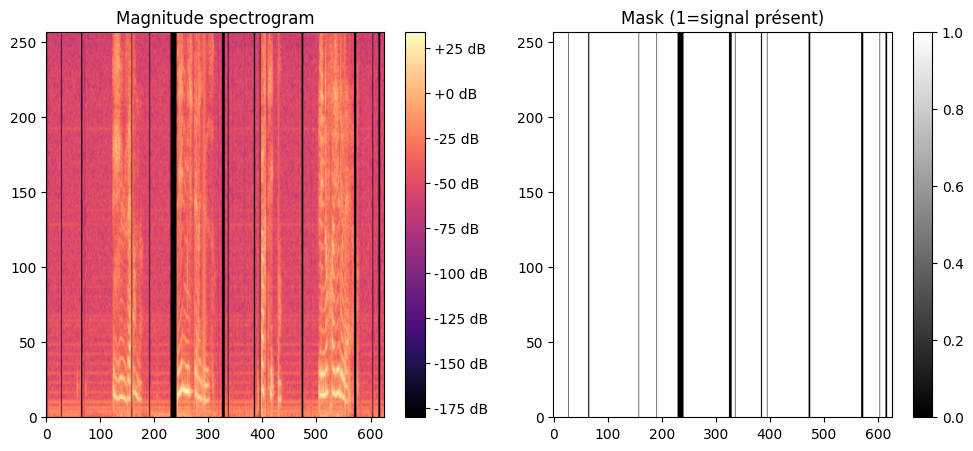

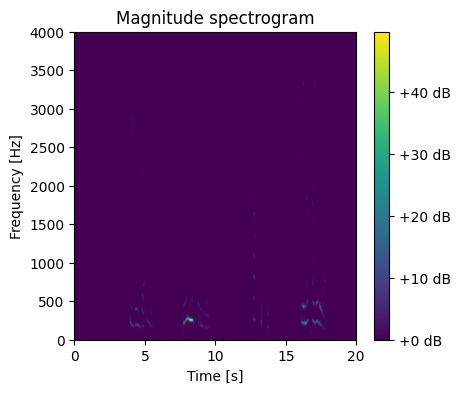

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 141350.0


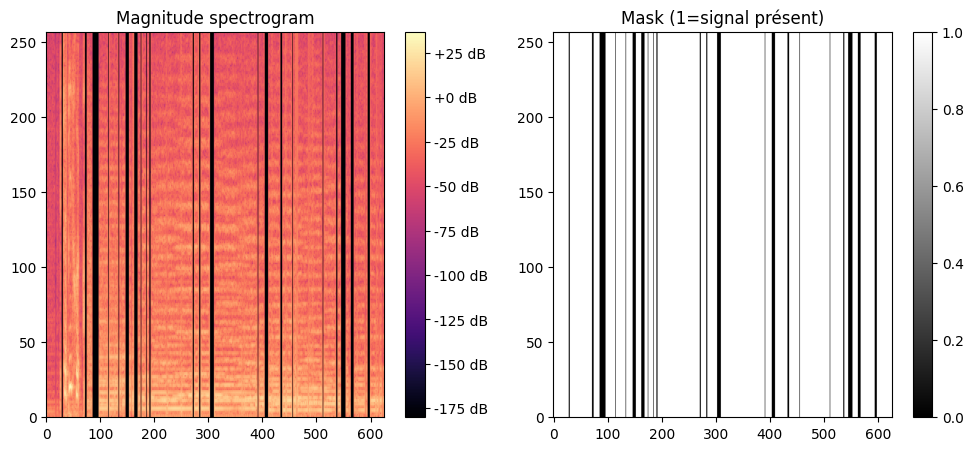

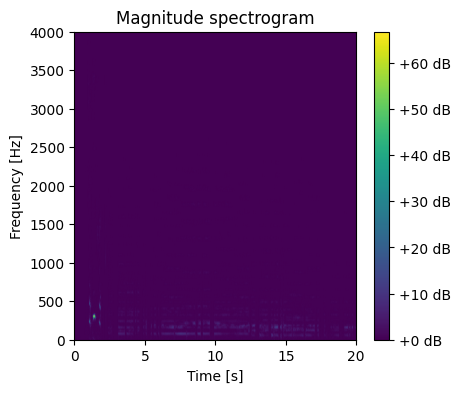

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 140064.0


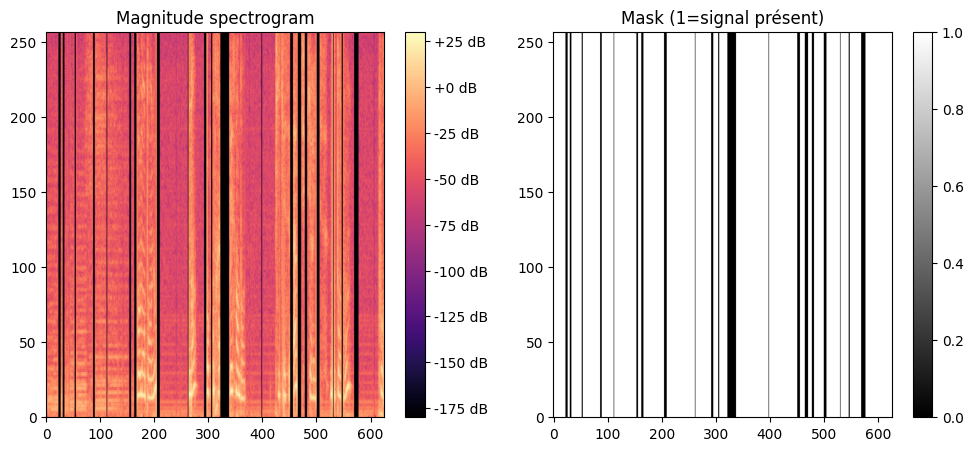

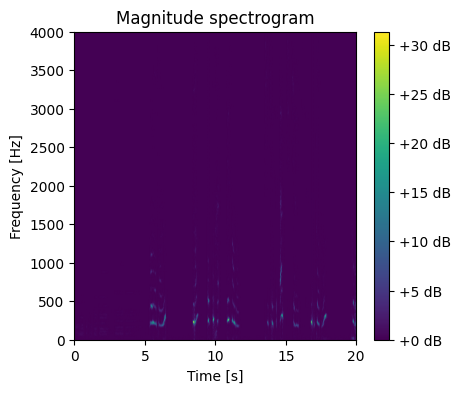

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 140064.0


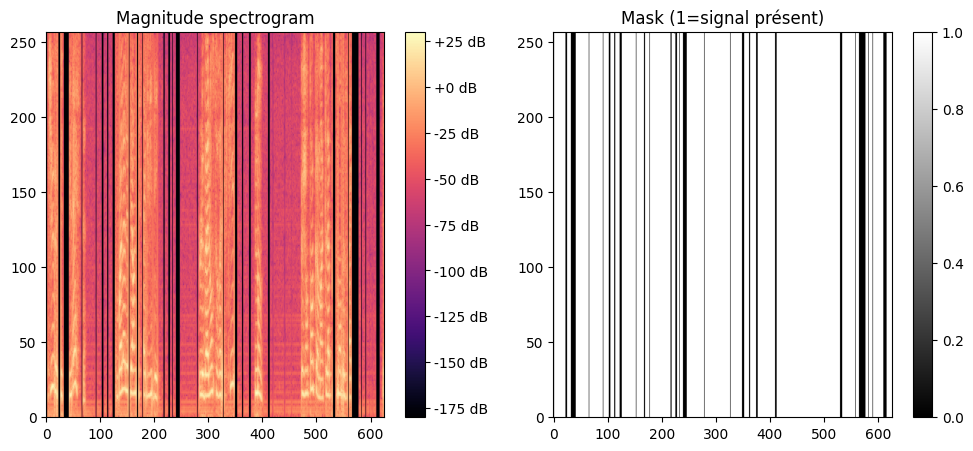

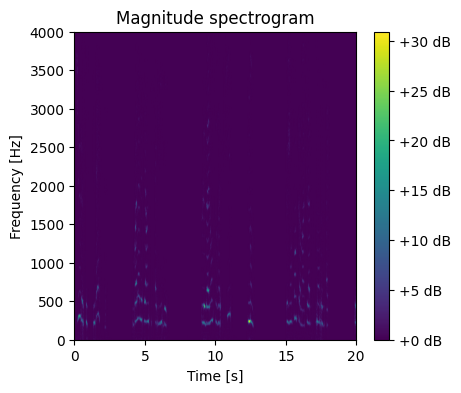

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 140322.0


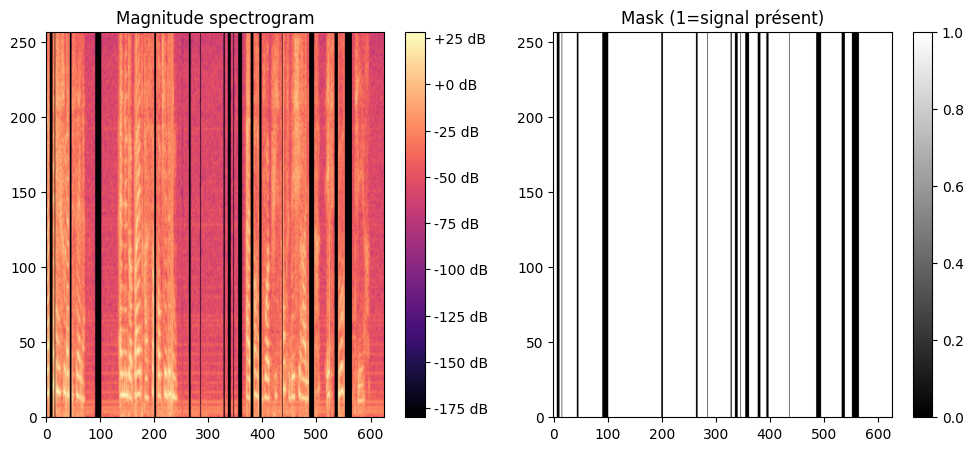

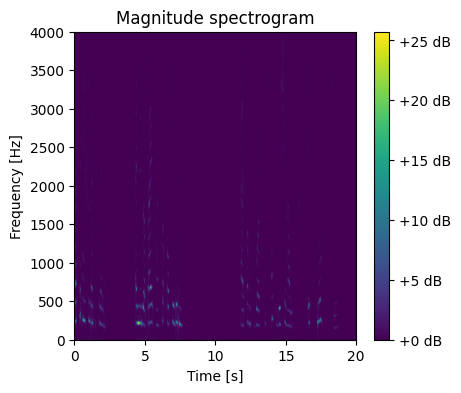

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 134411.0


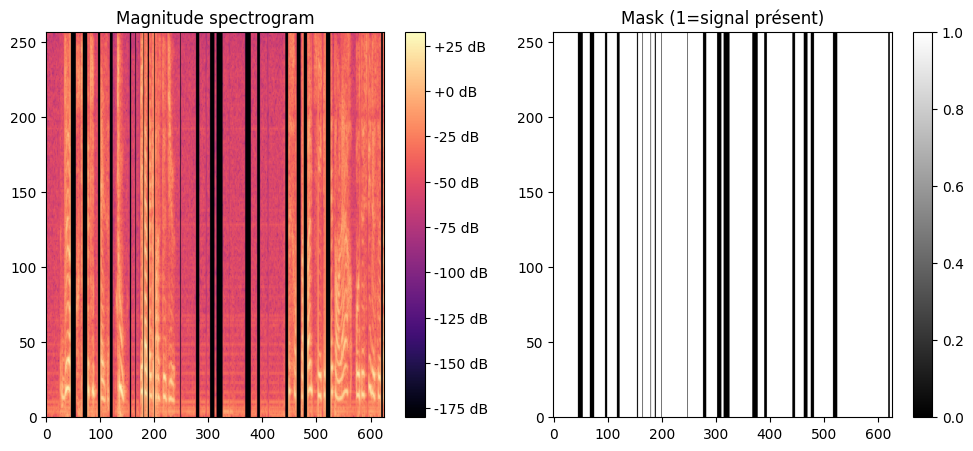

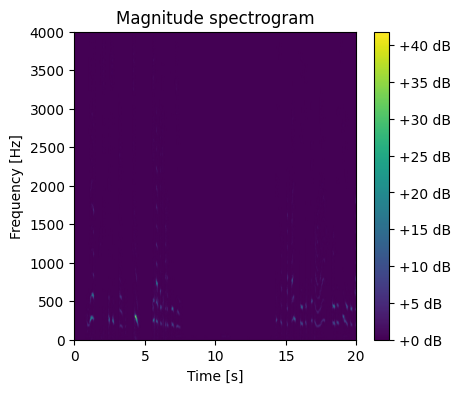

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 141093.0


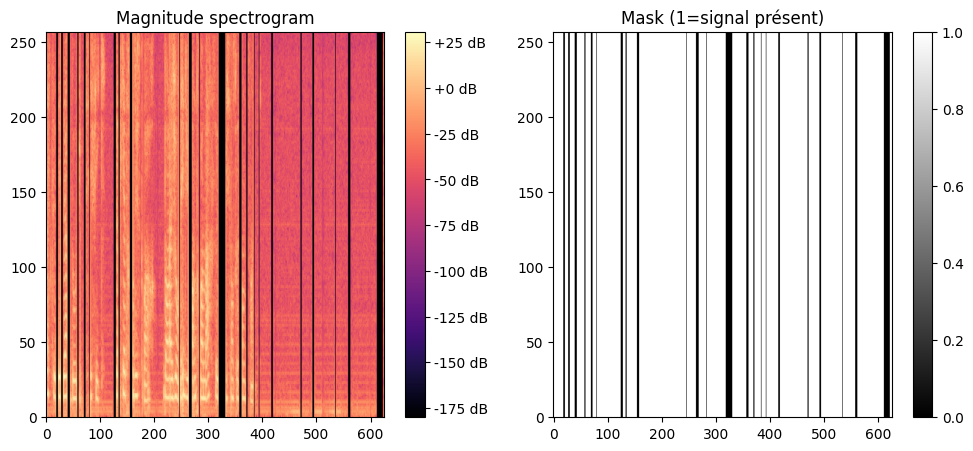

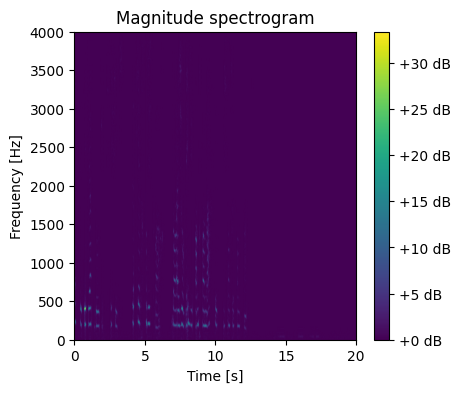

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 149831.0


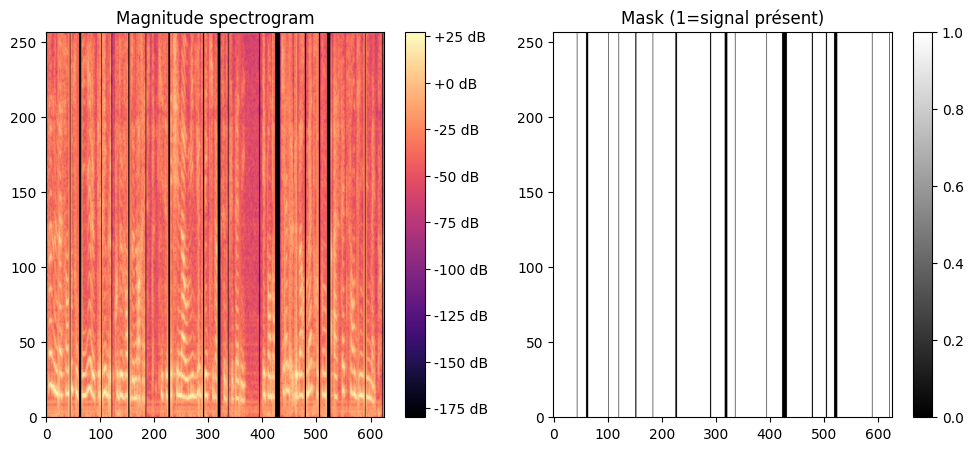

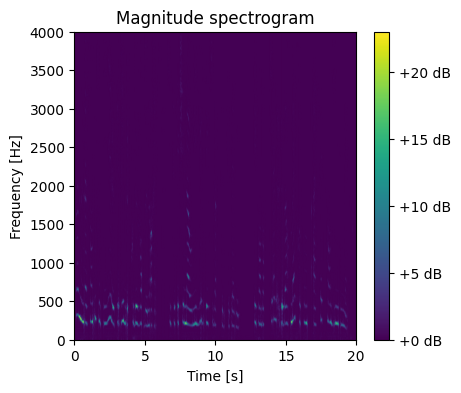

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 133896.0


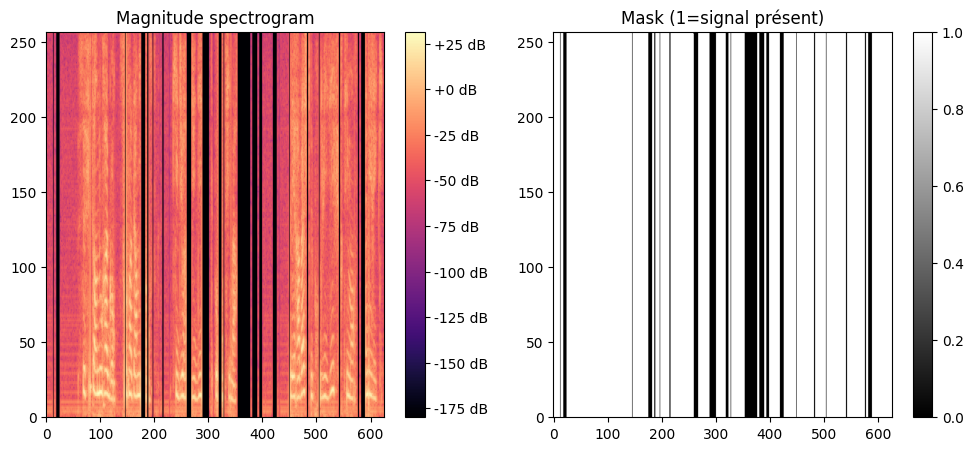

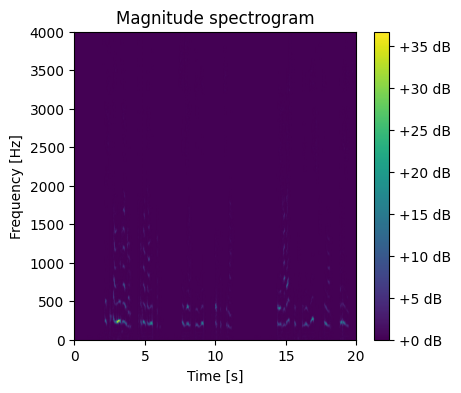

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']
Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav
STFT shape: torch.Size([257, 626]), Mask sum: 143406.0


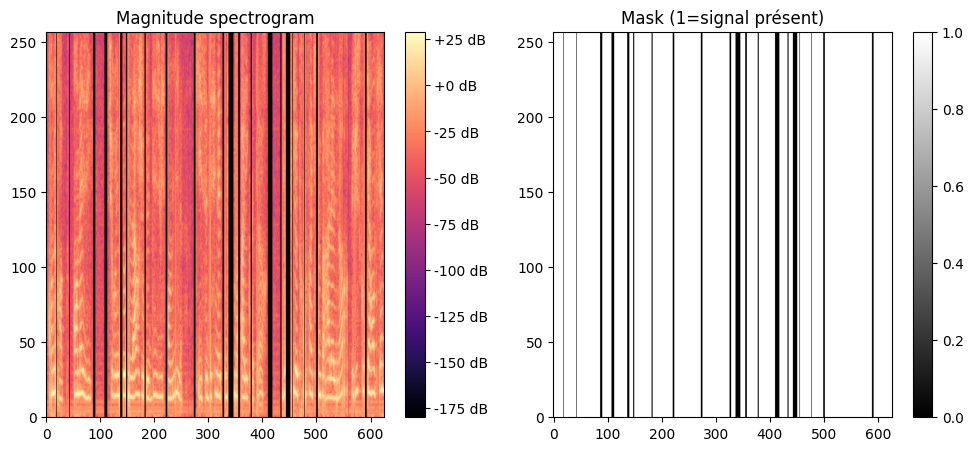

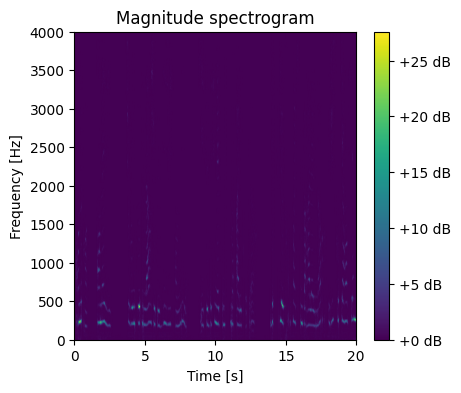

['Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_0_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_1_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_2_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_3_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_4_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_5_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_6_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_7_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_8_.wav', 'Jules_Verne_-_L_ile_mysterieuse_Partie1_Chap01_9_.wav']


In [ ]:
import matplotlib.pyplot as plt
import torch
import librosa

def test_stft_mask(wav_path, n_fft=512, hop_length=128, device="cpu"):
    """
    Charge un wav, calcule son STFT et crée un masque binaire.
    Affiche magnitude et masque pour vérification.
    """
    # 1. Charger le wav
    waveform_np, sr = librosa.load(wav_path, sr=None, mono=True)
    wav = torch.from_numpy(waveform_np).float().unsqueeze(0).to(device)  # (1, T)

    # 2. STFT
    window = torch.hann_window(n_fft, device=device)
    stft = torch.stft(
        wav.squeeze(0),
        n_fft=n_fft,
        hop_length=hop_length,
        window=window,
        return_complex=True
    )  # (F, T_frames)

    mag = stft.abs()
    mask = (mag > 1e-6).float()  # masque binaire

    print(f"STFT shape: {stft.shape}, Mask sum: {mask.sum().item()}")

    # 3. Visualisation
    plt.figure(figsize=(12,5))
    plt.subplot(1,2,1)
    plt.title("Magnitude spectrogram")
    plt.imshow(20*torch.log10(mag + 1e-9).cpu().numpy(), origin='lower', aspect='auto', cmap='magma') 
    plt.colorbar(format="%+2.0f dB")

    plt.subplot(1,2,2)
    plt.title("Mask (1=signal présent)")
    plt.imshow(mask.cpu().numpy(), origin='lower', aspect='auto', cmap='gray')
    plt.colorbar()
    plt.show()


    # Exemple d'utilisation
    if not os.path.exists(dir_packet_loss): os.makedirs(dir_packet_loss, exist_ok=True)
    files = [f for f in os.listdir(dir_packet_loss) if f.endswith('.wav')]
    print(files)
for file in files:
    print(file)
    test_stft_mask(os.path.join(dir_packet_loss,file))

In [20]:
import torch
import torchaudio
import pandas as pd
import os
from tqdm import tqdm

def compute_log_mag_stats(csv_path, sample_rate=8000, n_fft=512, hop_length=128, eps=1e-7, device='cpu'):
    """
    Parcourt tous les fichiers listés dans le CSV, calcule log-magnitude STFT
    et renvoie mean et std globales pour normalisation.
    
    Args:
        csv_path (str): chemin vers le CSV contenant au moins une colonne 'voice_origin_path'
        sample_rate (int): taux d'échantillonnage pour le chargement
        n_fft (int): taille de la fenêtre STFT
        hop_length (int): hop length STFT
        eps (float): petite valeur pour le log
        device (str): 'cpu' ou 'cuda'
    
    Returns:
        dataset_mean (float), dataset_std (float)
    """
    df = pd.read_csv(csv_path)
    sum_vals = 0.0
    sum_sq_diff = 0.0
    num_pixels = 0

    # Première passe pour la moyenne
    print("Calcul de la moyenne...")
    for idx, row in tqdm(df.iterrows(), total=len(df)):
        wav_path = row['voice_origin_path']
        if not os.path.exists(wav_path):
            continue
        
        waveform, sr = torchaudio.load(wav_path)
        if sr != sample_rate:
            waveform = torchaudio.functional.resample(waveform, sr, sample_rate)
        
        # mono si nécessaire
        if waveform.shape[0] > 1:
            waveform = waveform.mean(dim=0, keepdim=True)
        
        waveform = waveform.to(device)
        
        # STFT
        window = torch.hann_window(n_fft, device=device)
        stft = torch.stft(
            waveform.squeeze(0),
            n_fft=n_fft,
            hop_length=hop_length,
            window=window,
            return_complex=True
        )
        
        mag = stft.abs()
        log_mag = torch.log(mag + eps)
        
        sum_vals += log_mag.sum().item()
        num_pixels += log_mag.numel()
    
    dataset_mean = sum_vals / num_pixels
    print(f"Mean computed: {dataset_mean:.6f}")

    # Deuxième passe pour std
    print("Calcul de l'écart-type...")
    for idx, row in tqdm(df.iterrows(), total=len(df)):
        wav_path = row['voice_origin_path']
        if not os.path.exists(wav_path):
            continue
        
        waveform, sr = torchaudio.load(wav_path)
        if sr != sample_rate:
            waveform = torchaudio.functional.resample(waveform, sr, sample_rate)
        if waveform.shape[0] > 1:
            waveform = waveform.mean(dim=0, keepdim=True)
        waveform = waveform.to(device)

        window = torch.hann_window(n_fft, device=device)
        stft = torch.stft(
            waveform.squeeze(0),
            n_fft=n_fft,
            hop_length=hop_length,
            window=window,
            return_complex=True
        )
        
        mag = stft.abs()
        log_mag = torch.log(mag + eps)
        sum_sq_diff += ((log_mag - dataset_mean) ** 2).sum().item()
    
    dataset_std = (sum_sq_diff / num_pixels) ** 0.5
    print(f"Std computed: {dataset_std:.6f}")

    return dataset_mean, dataset_std


ModuleNotFoundError: No module named 'torchaudio'